## Import

In [1]:
import pandas as pd
import scvelo as scv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import scipy.sparse
import os
import sys
import scanpy.external as sce
from importlib import reload
import numpy as np
import pickle
import gseapy
import os
import bbknn
import sys
import shutil
import scrublet as scr
import ipywidgets as widgets
import wot
import copy
import re
import seaborn as sns
import math
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=500, frameon=False, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True)

In [2]:
import matplotlib.pyplot as plt
import matplotlib.colors
baguette = matplotlib.colors.LinearSegmentedColormap.from_list("", ["whitesmoke","dodgerblue","blue"])

In [3]:
Progenitors = '#1f77b4'
BrownAdipocytes ='#ff7f0e'
ConnectiveTissue ='#279e68'
Dermis ='#d62728'
DermisPrecursors ='#c45b41'
Bone= '#aa40fc'
BrownAdipocytesPrecursors ='#8c564b'
SmoothMuscle= '#e377c2'
Cartilage ='#b5bd61'
CartilagePrecursors= '#8ebf84'
Tendon ='#17becf'
Blood ='#aec7e8'

Endothelial='#ccbeab'
SkMpre='#d4a363'
Macrophage='#dcebd1'
SchwannCell='#d1d9eb'
Epidermis='#ebd1d1'
SkeletalMuscle='#78295f'
Meninges='#d1e5eb'
Neutrophils='#eaebd1'
MastCell='#e5d1eb'

## Original data

In [14]:
adata_pre = sc.read('datasets/mice_logYESnormNO_v1.h5ad')

#RAW - NO NORM - YES LOG

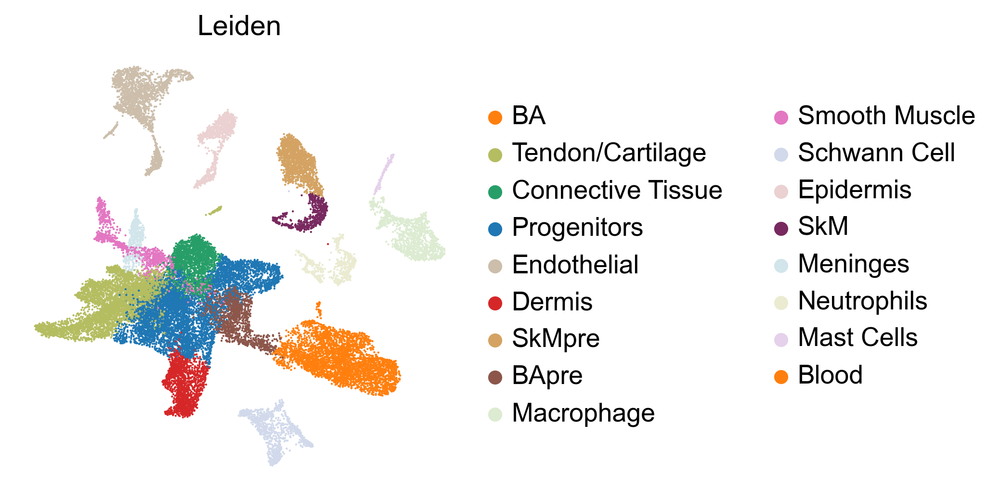

In [ ]:
sc.pl.umap(adata_pre, color=['leiden'], title='Leiden',
           palette=[BrownAdipocytes,Cartilage,ConnectiveTissue,Progenitors,Endothelial,Dermis,SkMpre,BrownAdipocytesPrecursors,Macrophage,SmoothMuscle,SchwannCell,Epidermis,SkeletalMuscle,Meninges,Neutrophils,MastCell], save='all_leiden_id.pdf')

In [48]:
len(adata_pre.obs.leiden.cat.categories)

17

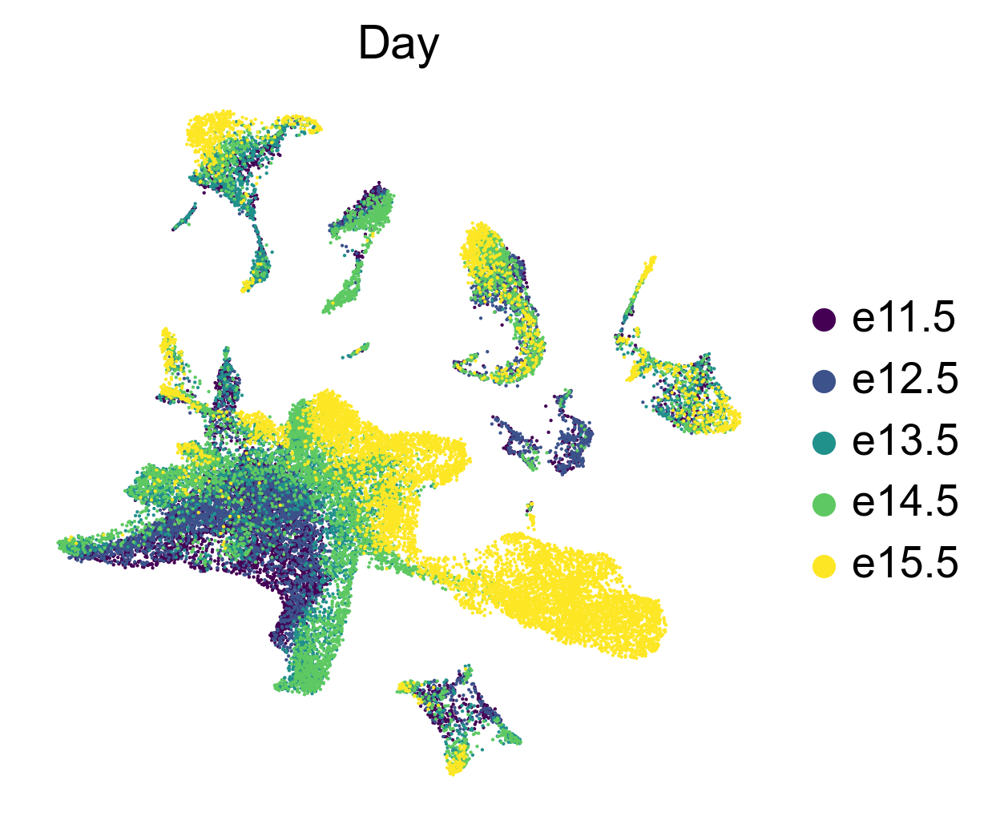

In [61]:
sc.pl.umap(adata_pre, color=['time_id'], title='Day', save='all_time_id.pdf', palette='viridis')

## Bar graph

In [97]:
import copy
adata_pre.obs['pro']=''
cluster_key="pro"
sample_key="time_id"
adata_tmp = adata_pre.copy()

import scanpy_cluster_proportions_v2
cluster_props = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=cluster_key, sample_key=sample_key)

In [98]:
cluster_props

pro,
time_id,
e11.5,5122
e12.5,4384
e13.5,4500
e14.5,5856
e15.5,8382


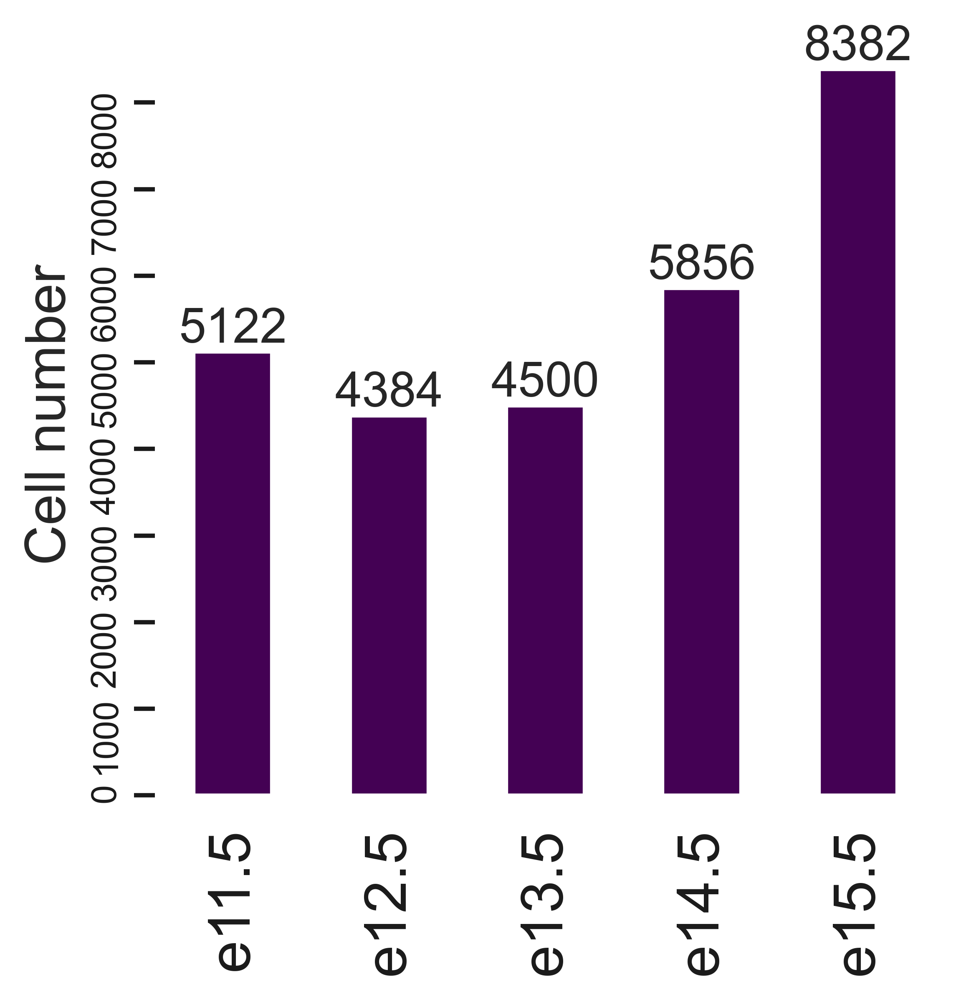

In [129]:
cluster_palette=['#440154', '#3b528b', '#21918c', '#5ec962', '#fde725']
xlabel_rotation=90
taillepolice=10

fig, ax = plt.subplots(dpi=300)
fig.patch.set_facecolor("white")

cmap = None
if cluster_palette is not None:
    cmap = sns.palettes.blend_palette(
        cluster_palette, 
        n_colors=len(cluster_palette), 
        as_cmap=True)

cluster_props.plot(
    kind="bar",
    stacked=True, 
    ax=ax, 
    legend=False,
    colormap=cmap,
    fontsize='large'
)

#ax.legend(bbox_to_anchor=(1.01, 1), frameon=True, title="Cluster")
sns.despine(fig, ax, left=True, bottom=True)
ax.tick_params(axis="y", rotation=xlabel_rotation, labelsize=taillepolice)
ax.set_xlabel('')
ax.set_ylabel("Cell number", fontsize=16)
ax.yaxis.set_label_position("left")
ax.yaxis.tick_left()
fig.set_size_inches(4,4)
ax.bar_label(ax.containers[0])
plt.yticks(rotation = 90)
ax.grid(False)
plt.savefig('figures/mice_all_timepoints_bar_graph.pdf', bbox_inches = 'tight')

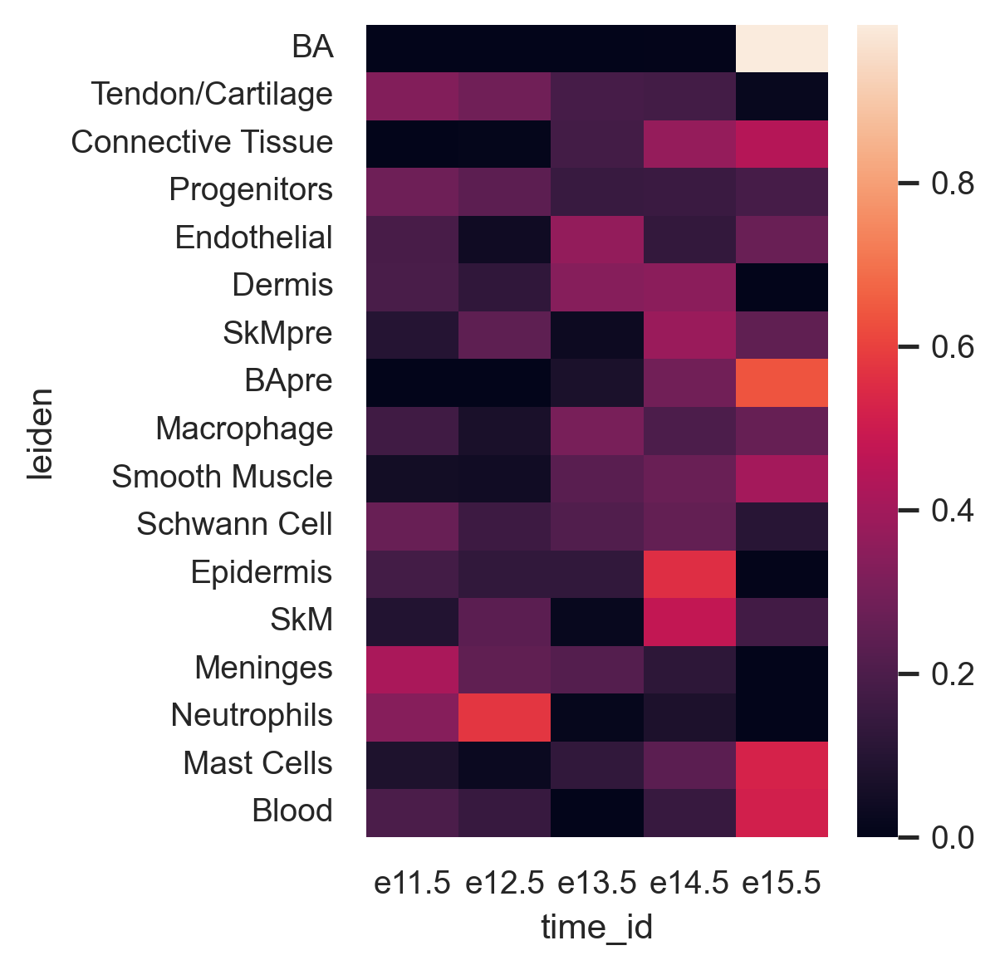

In [130]:
import scanpy as sc; import seaborn as sns
sns.set(font_scale=0.85)
cmtx = sc.metrics.confusion_matrix("leiden", "time_id", adata_pre.obs)
sns_plot = sns.heatmap(cmtx)
sfig = sns_plot.get_figure()
sfig.tight_layout()
sfig.savefig('figures/filename.pdf',  orientation="landscape")

## Heatmap

In [52]:
list_genes = ['Scx', 'Cnmd', 'Cnn1', 'Ngfr', 'Cldn11', 'Cdh5', 'Csf1r', 'Srgn', 'Myog', 'Hba-a2', 'Sox10', 'Krt5']

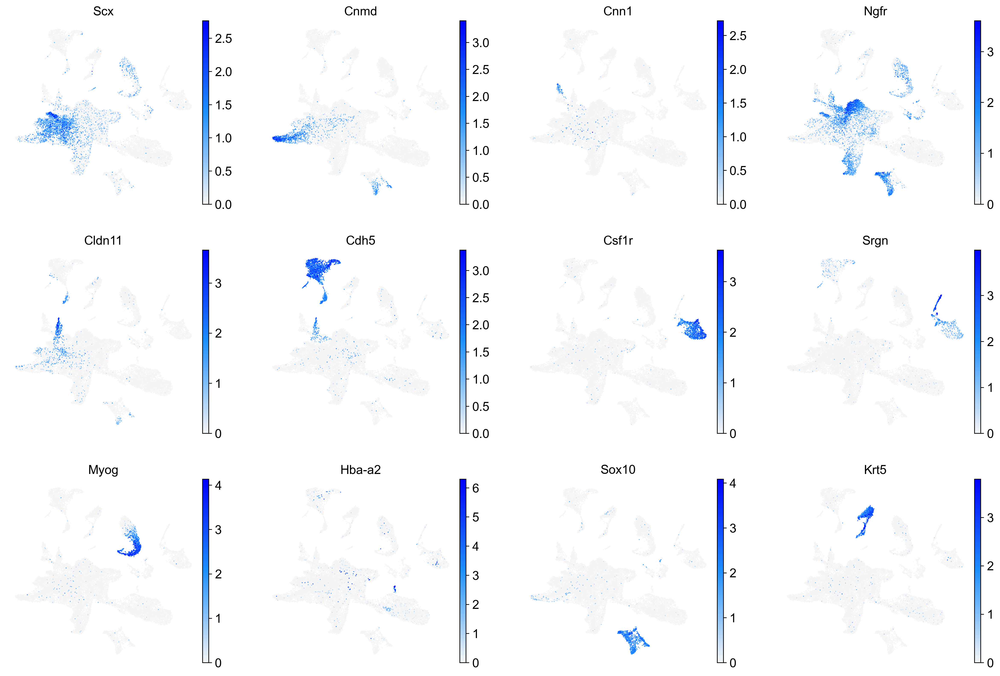

In [53]:
sc.pl.umap(adata_pre, color=list_genes, color_map=baguette, save='mice_all_timepoints_raw_UMAP_curated')

## Dotplot

In [54]:
markers = {'T-cell': 'CD3D', 'B-cell': 'CD79A', 'myeloid': 'CST3'}

In [55]:
markers = {'Brown Adipocytes': ['Cidea', 'Ucp1'],
           'Skeletal Muscle': ['Myog', 'Ttn', 'Actn2', 'Myh3'],
           'Dermal Fibroblast': ['Twist2', 'Dpt', 'Crabp1'],
           'Smooth Muscle': ['Cnn1', 'Acta2'],
           'Muscle connective tissue': ['Ngfr', 'Osr1', 'Osr2'],
           'Cartilage': ['Cnmd', 'Col2a1'],
           'Endothelial Cells': ['Cdh5', 'Kdr'],
           'Meninges': ['Foxc1', 'Cldn11', 'Aldh1a2'],
           'Macrophages': ['Csf1r', 'C1qb'],
           'Mast Cells': ['Srgn', 'Kit'],
           'Neutrophils': ['Ngp', 'Lcn2'],
           'Schwann Cells': ['Sox10', 'Mpz'],
           'Epidermal Cells': ['Krt5', 'Krt14'],
          }

In [56]:
sc.tl.rank_genes_groups(adata_pre, groupby='leiden', method = "wilcoxon", n_jobs=-1)
excel_total = pd.DataFrame(adata_pre.uns['rank_genes_groups']['names']).iloc[0:1000,:]

In [58]:
excel_total.to_excel("figures/output_raw.xlsx")  

In [23]:
excel_total.head(5)

,BA,Tendon/Cartilage,Connective Tissue,Progenitors,Endothelial,Dermis,SkMpre,BApre,Macrophage,Smooth Muscle,Schwann Cell,Epidermis,SkM,Meninges,Neutrophils,Mast Cells,Blood
0,Car3,Col11a1,Col6a3,Ptn,Cdh5,Twist2,Capn6,Dlk1,Tmsb4x,Col4a1,Sox10,Krt5,Actc1,Igfbp2,Tubb2b,Cpa3,Hba-a2
1,Aco2,Col2a1,Col6a2,Col3a1,Kdr,Crabp1,Cdkn1c,Lpl,Laptm5,Col4a2,Ednrb,Ptprf,Myog,Gja1,Tuba1a,Gata2,Hba-a1
2,Fabp4,Mdk,Dlk1,Col1a2,Pecam1,Twist1,Ppp1r14b,Gsn,Actb,Notch3,Plp1,Perp,Cdkn1c,Zic1,Sox11,Srgn,Hbb-bs
3,Idh3a,Col9a2,Col6a1,Gpc3,Egfl7,Irx1,Pdgfa,Col6a2,Serinc3,Cald1,Gpm6b,Dsp,Tpm2,Foxc1,Tubb3,Hdc,Hbb-bt
4,Gm10053,H19,Igf1,Meg3,Tmsb4x,Tmem132c,Msc,Col6a1,Csf1r,Igfbp7,Fabp7,Krt14,Spg21,Epha7,Basp1,Rac2,Alas2


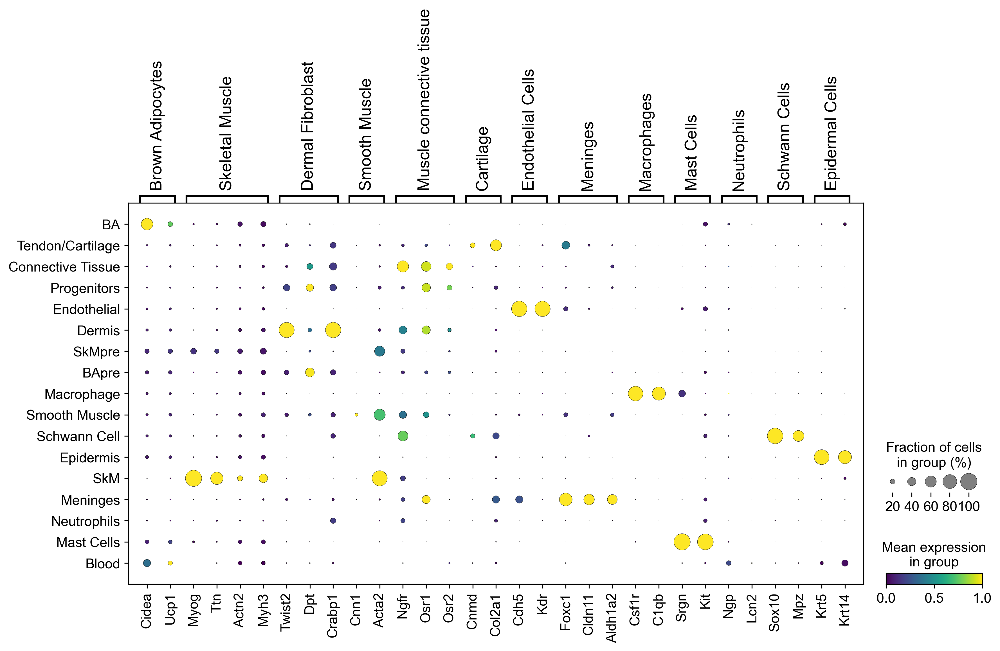

In [24]:
sc.pl.dotplot(adata_pre, var_names=markers ,groupby='leiden',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='mice_all_timepoints_dotplot_leiden_raw_mice_subcluster.pdf', 
              title='')

In [400]:
adata_pre.obs['count'] = 0
cluster_key="count"
sample_key="time_id"
adata_tmp = adata_pre.copy()
import scanpy_cluster_proportions_v2
cluster_props = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=cluster_key, sample_key=sample_key)
cluster_props

count,0
time_id,
e11.5,5122
e12.5,4384
e13.5,4500
e14.5,5856
e15.5,8382


## Individual timepoints analysis

### e11_5

In [437]:
adata=sc.read('datasets/11_5.h5ad')

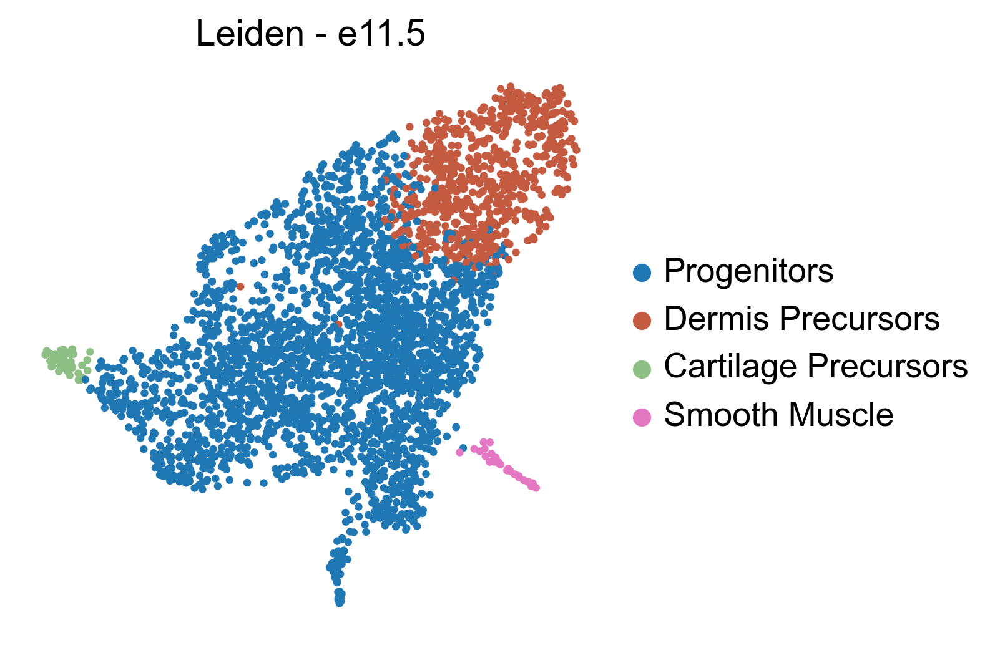

In [6]:
sc.pl.umap(adata, color=['clusters'], title='Leiden - e11.5', save='e11_leiden.pdf',
           palette=[Progenitors,DermisPrecursors,CartilagePrecursors,SmoothMuscle])

### e12_5

In [442]:
adata=sc.read('datasets/12_5.h5ad')

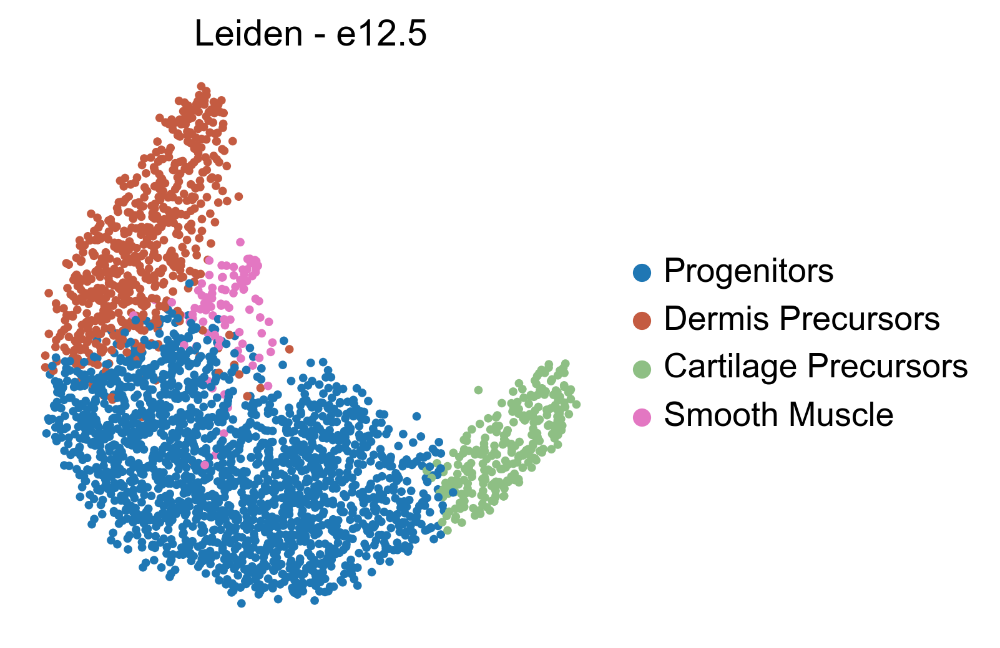

In [9]:
sc.pl.umap(adata, color=['clusters'], title='Leiden - e12.5', save='e12_leiden.pdf',
           palette=[Progenitors,DermisPrecursors,CartilagePrecursors,SmoothMuscle])

### e13_5

In [446]:
adata=sc.read('datasets/13_5.h5ad')

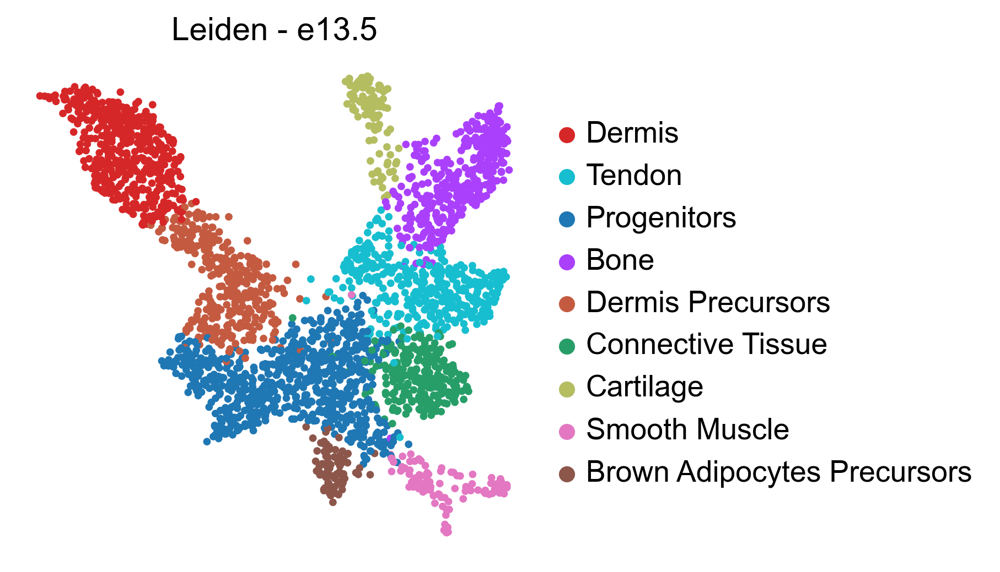

In [12]:
sc.pl.umap(adata, color=['clusters'], title='Leiden - e13.5', save='e13_leiden.pdf',
           palette=[Dermis,Tendon,Progenitors,Bone,DermisPrecursors,ConnectiveTissue,Cartilage,SmoothMuscle,BrownAdipocytesPrecursors])

### e14_5

In [450]:
adata=sc.read('datasets/14_5.h5ad')

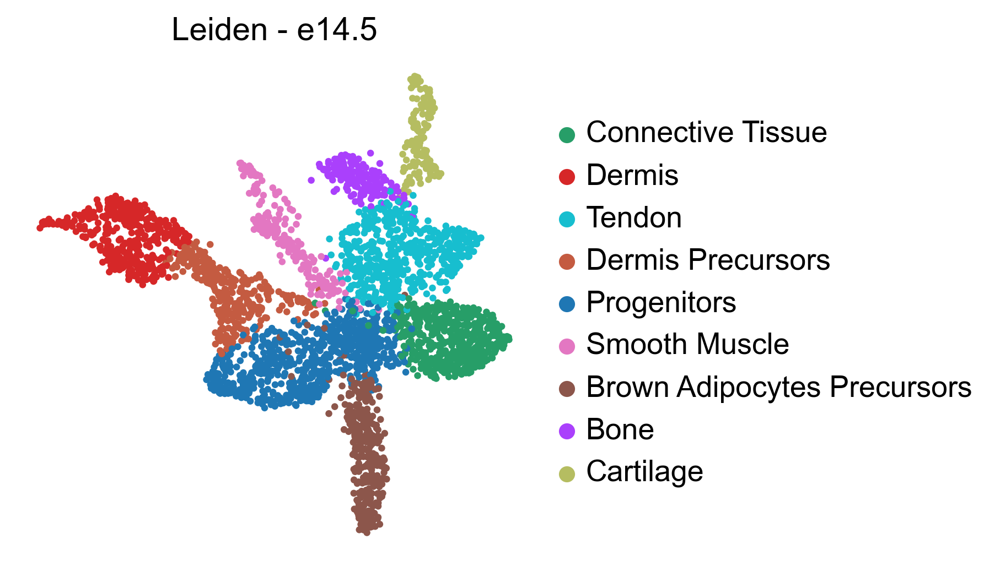

In [15]:
sc.pl.umap(adata, color=['clusters'], title='Leiden - e14.5', save='e14_leiden.pdf',
           palette=[ConnectiveTissue,Dermis,Tendon,DermisPrecursors,Progenitors,SmoothMuscle,BrownAdipocytesPrecursors,Bone,Cartilage])

### e15_5

In [454]:
adata=sc.read('datasets/15_5.h5ad')

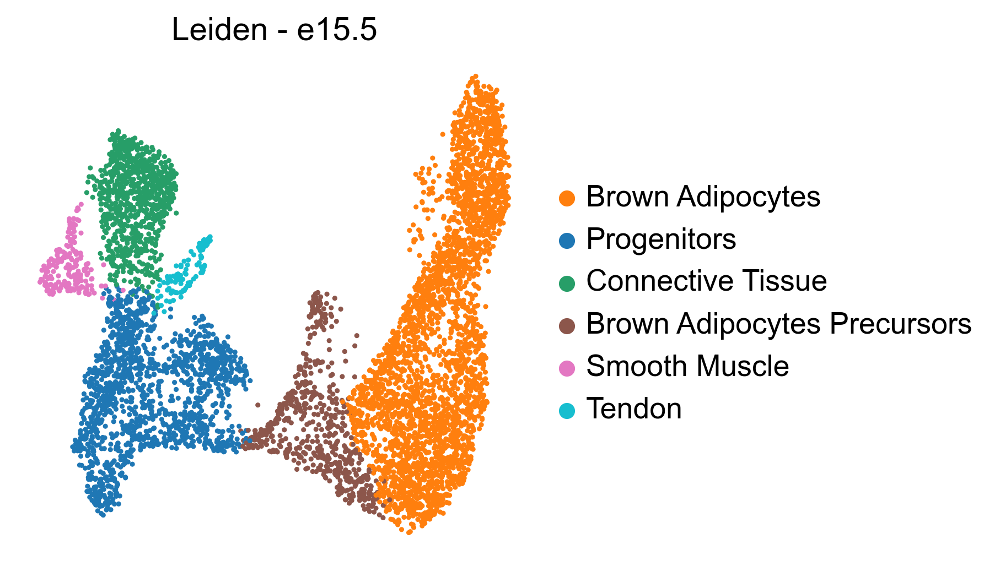

In [18]:
sc.pl.umap(adata, color=['leiden_e15'], title='Leiden - e15.5', save='e15_leiden.pdf',
          palette=[BrownAdipocytes,Progenitors,ConnectiveTissue,BrownAdipocytesPrecursors,SmoothMuscle,Tendon])

## Merged/Processed timepoints analysis

In [3]:
adata = sc.read('datasets/all_mice_timepoints_processed.h5ad')

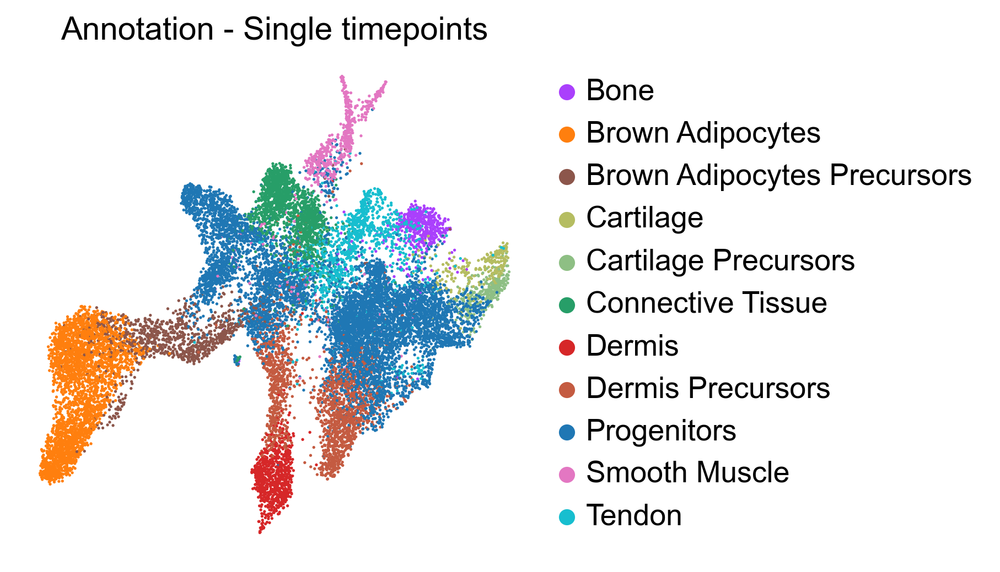

In [38]:
sc.pl.umap(adata, color=['clusters_og'], title='Annotation - Single timepoints', save='mouse_single_timepoints_annotation.pdf',
           palette=['#aa40fc', '#ff7f0e', '#8c564b', '#b5bd61', '#8ebf84', '#279e68', '#d62728', '#c45b41', '#1f77b4', '#e377c2', '#17becf'])

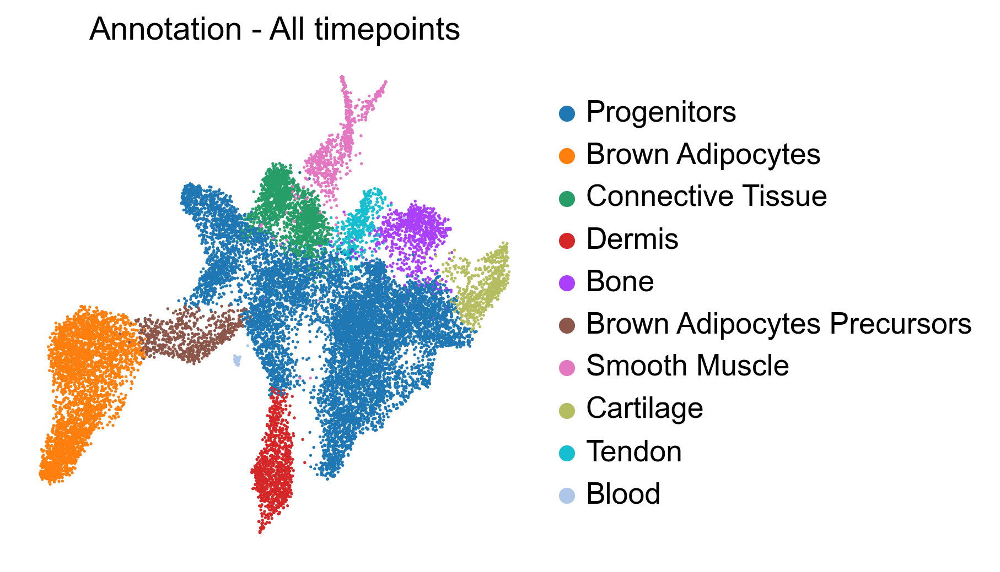

In [529]:
sc.pl.umap(adata, color=['clusters'], title='Annotation - All timepoints', save='mouse_all_timepoints_annotation.pdf',
           palette=['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78'])

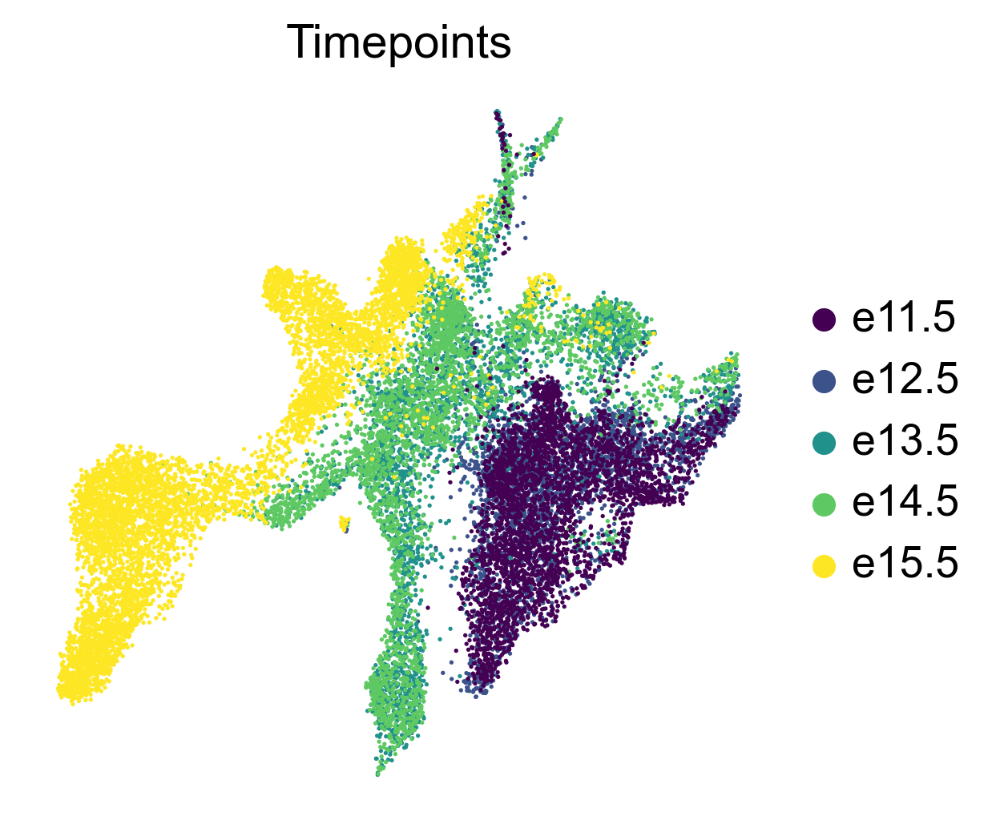

In [530]:
sc.pl.umap(adata, color=['time'], palette='viridis', title='Timepoints', save='mouse_alltimepoints_time.pdf')

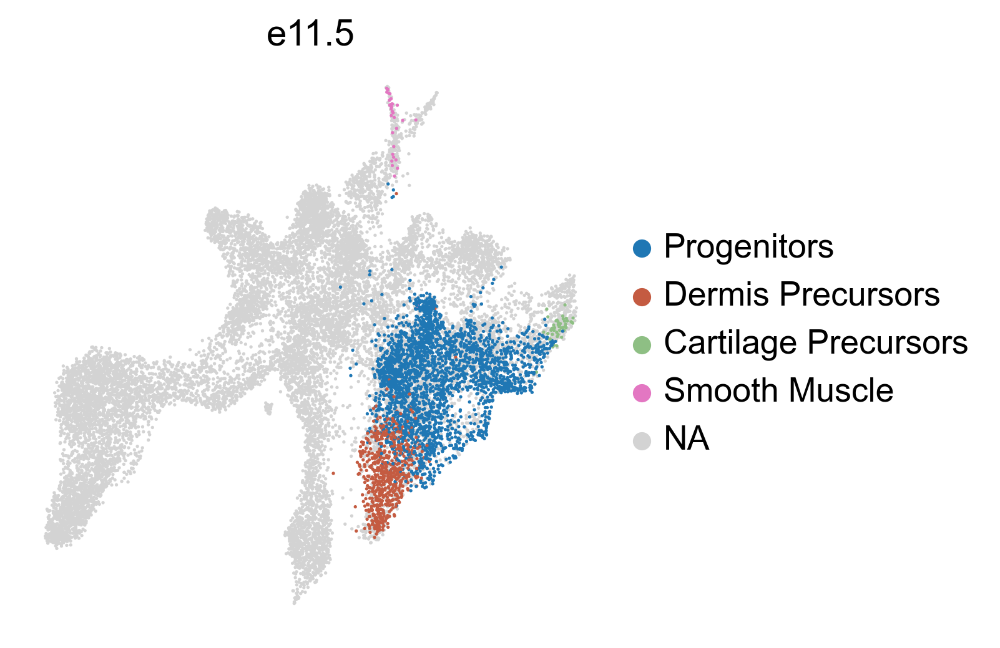

In [531]:
sc.pl.umap(adata, color=['leiden_e11'], title='e11.5', save='mouse_all_11.pdf',
           palette=[Progenitors,DermisPrecursors,CartilagePrecursors,SmoothMuscle])

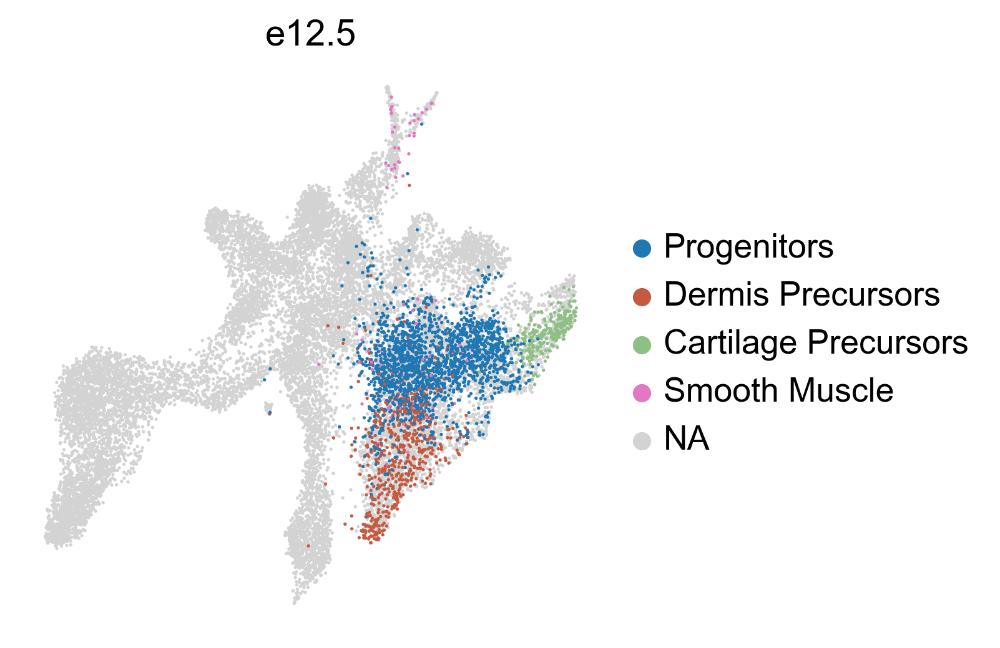

In [532]:
sc.pl.umap(adata, color=['leiden_e12'], title='e12.5', save='mouse_all_12.pdf',
           palette=[Progenitors,DermisPrecursors,CartilagePrecursors,SmoothMuscle])

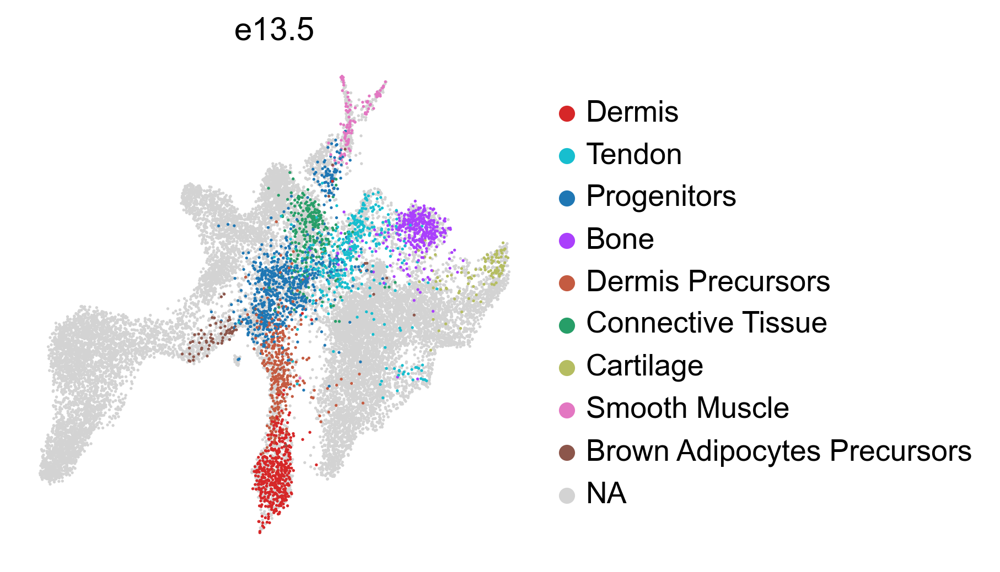

In [533]:
sc.pl.umap(adata, color=['leiden_e13'], title='e13.5', save='mouse_all_13.pdf',
           palette=[Dermis,Tendon,Progenitors,Bone,DermisPrecursors,ConnectiveTissue,Cartilage,SmoothMuscle,BrownAdipocytesPrecursors])

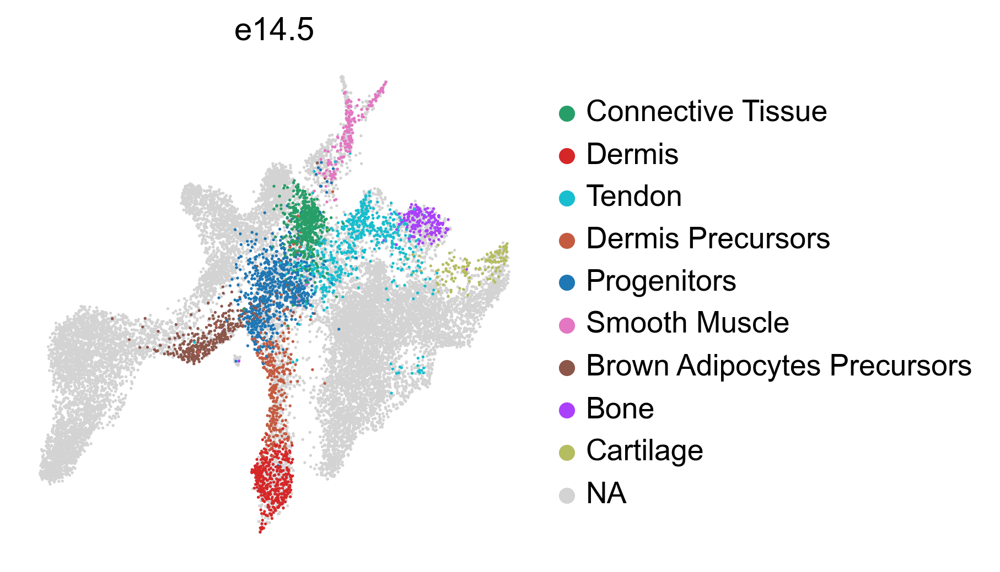

In [534]:
sc.pl.umap(adata, color=['leiden_e14'], title='e14.5', save='mouse_all_14.pdf',
           palette=[ConnectiveTissue,Dermis,Tendon,DermisPrecursors,Progenitors,SmoothMuscle,BrownAdipocytesPrecursors,Bone,Cartilage])

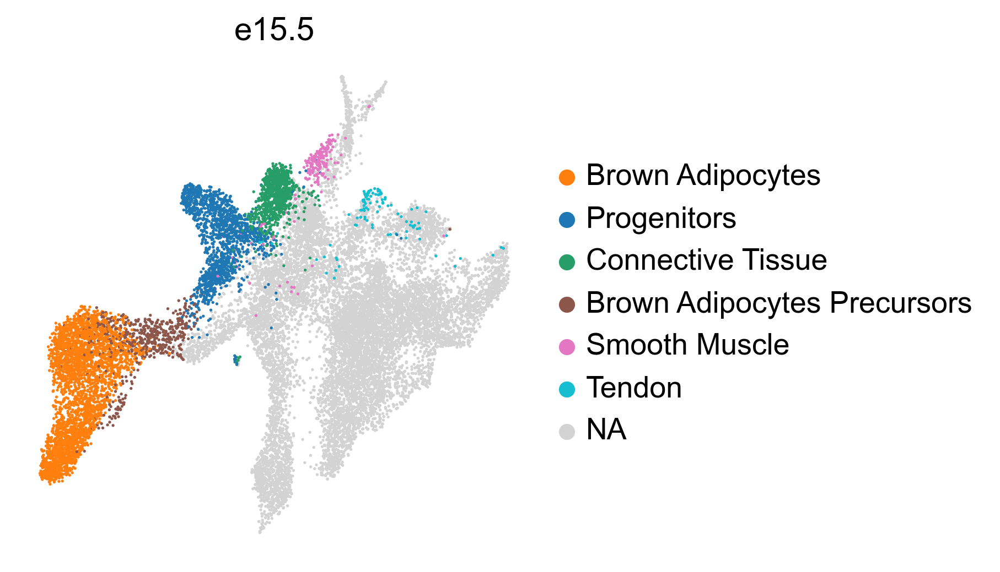

In [535]:
sc.pl.umap(adata, color=['leiden_e15'], title='e15.5', save='mouse_all_15.pdf',
           palette=[BrownAdipocytes,Progenitors,ConnectiveTissue,BrownAdipocytesPrecursors,SmoothMuscle,Tendon])

In [310]:
sc.tl.rank_genes_groups(adata, groupby='clusters', method = "wilcoxon", n_jobs=-1)
excel_total = pd.DataFrame(adata.uns['rank_genes_groups']['names']).iloc[0:1000,:]

In [ ]:
excel_total.to_excel("output.xlsx")  

In [311]:
excel_total.head(5)

,Progenitors 1,Brown Adipocytes,Progenitors 2,Connective Tissue,Dermis,Bone,Brown Adipocytes Precursors,Smooth Muscle,Cartilage,Tendon,Blood
0,Mdk,Fabp4,Dlk1,Col6a3,Crabp1,Col8a2,Eif5a,Col4a1,Col2a1,Thbs4,Hba-a1
1,Marcksl1,Car3,Sparc,Col6a2,Twist2,Col1a1,Fabp5,Col4a2,Col9a2,Fn1,Hba-a2
2,Sox11,Aco2,Col3a1,Col6a1,Lum,Bgn,Mgst1,Tmsb4x,Col9a3,Postn,Alas2
3,Actg1,Dbi,Col1a1,Capn6,Irx1,H19,Npm1,Acta2,Col9a1,Fibin,Mkrn1
4,Hnrnpa1,Idh3a,Col1a2,Dlk1,Lgals1,Col11a1,Col15a1,Notch3,Sox9,C1qtnf3,Slc25a37


## Heatmap

In [536]:
list_genes = ['Scx', 'Cnmd', 'Cnn1', 'Ngfr', 'Cldn11', 'Cdh5', 'Csf1r', 'Srgn', 'Ngp', 'Hba-a1', 'Sox10', 'Krt5']

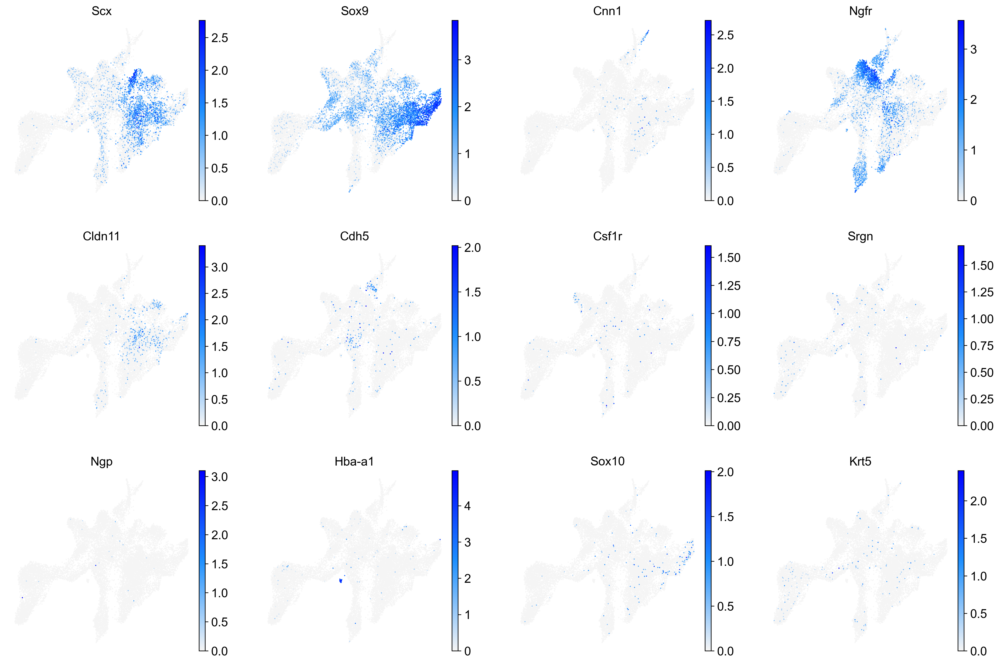

In [537]:
sc.pl.umap(adata, color=list_genes, color_map=baguette, save='mice_all_timepoints_UMAP_curated')

In [32]:
markers_2 = ['Ebf2', 'Pparg', 'Cidea', 'Ucp1']

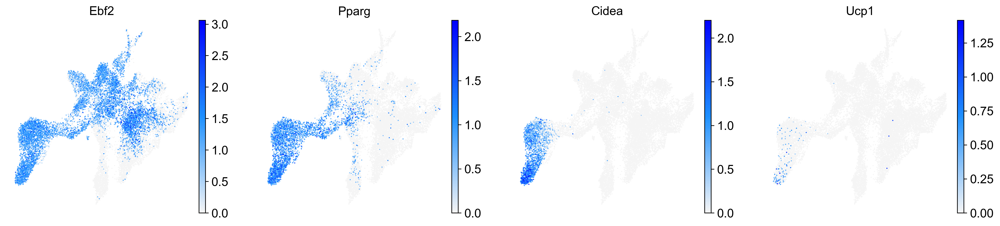

In [35]:
sc.pl.umap(adata, color=markers_2, color_map=baguette, save='mice_all_timepoints_UMAP_curated2')

In [5]:
markers_final = ['Pdgfra', 'Hic1', 'Ebf2', 'Gata6', 'Pparg', 'Cebpa', 'Cidea', 'Ucp1']

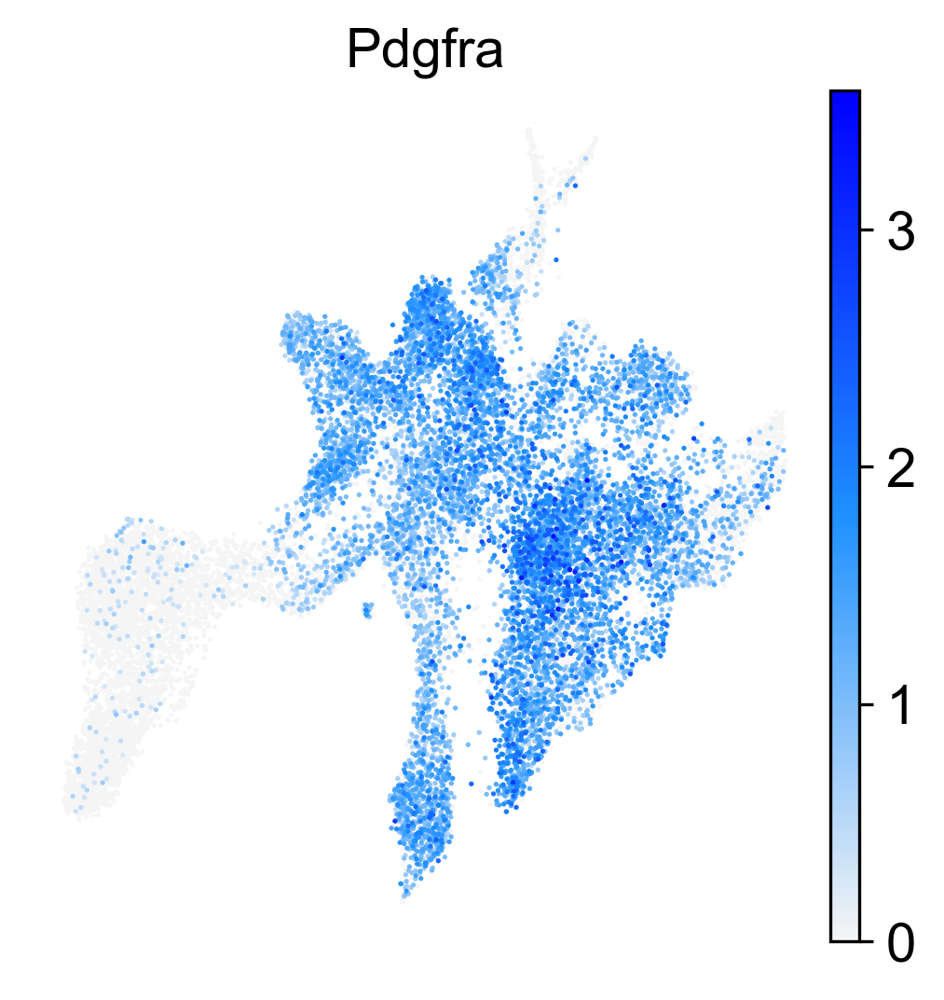

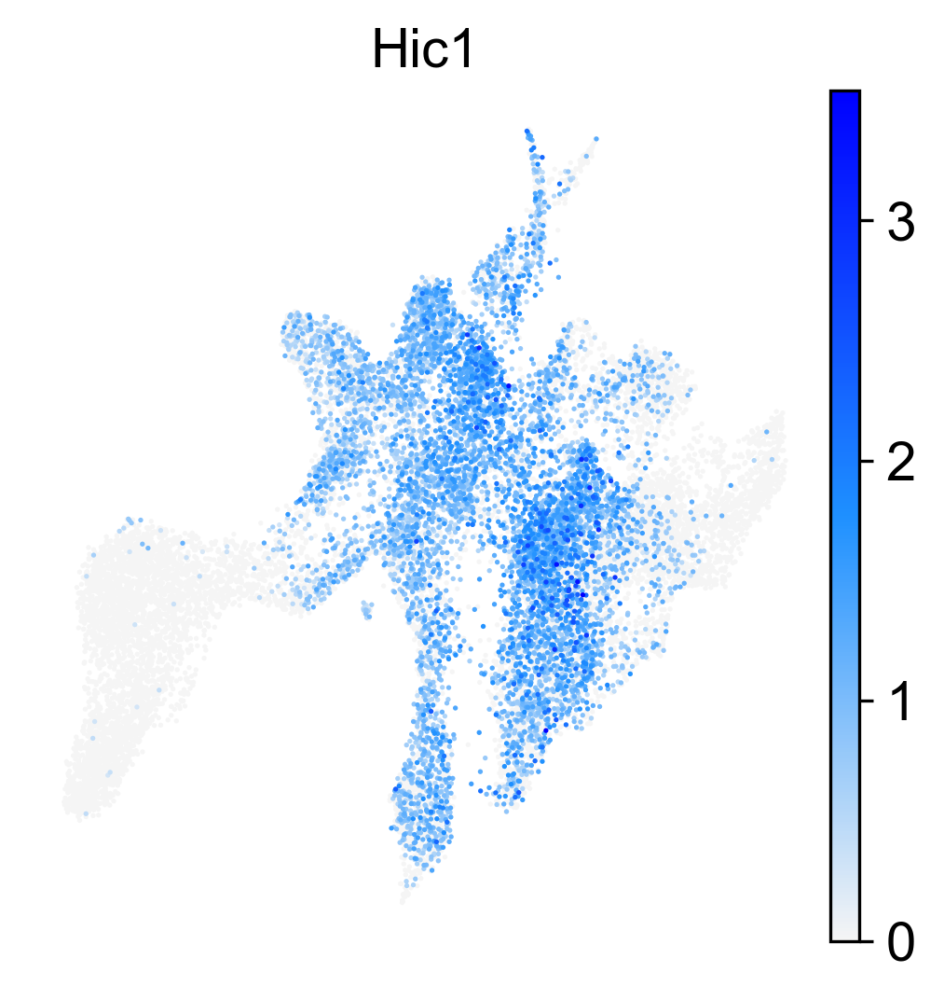

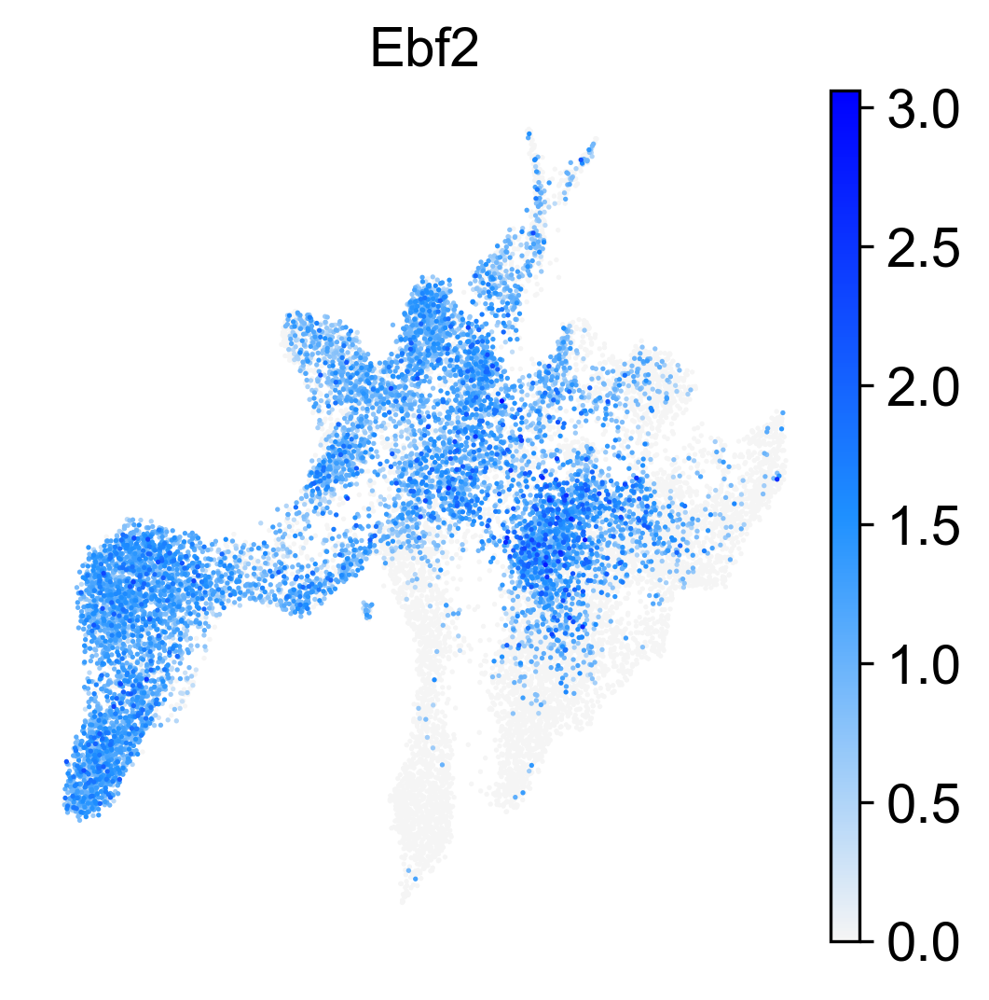

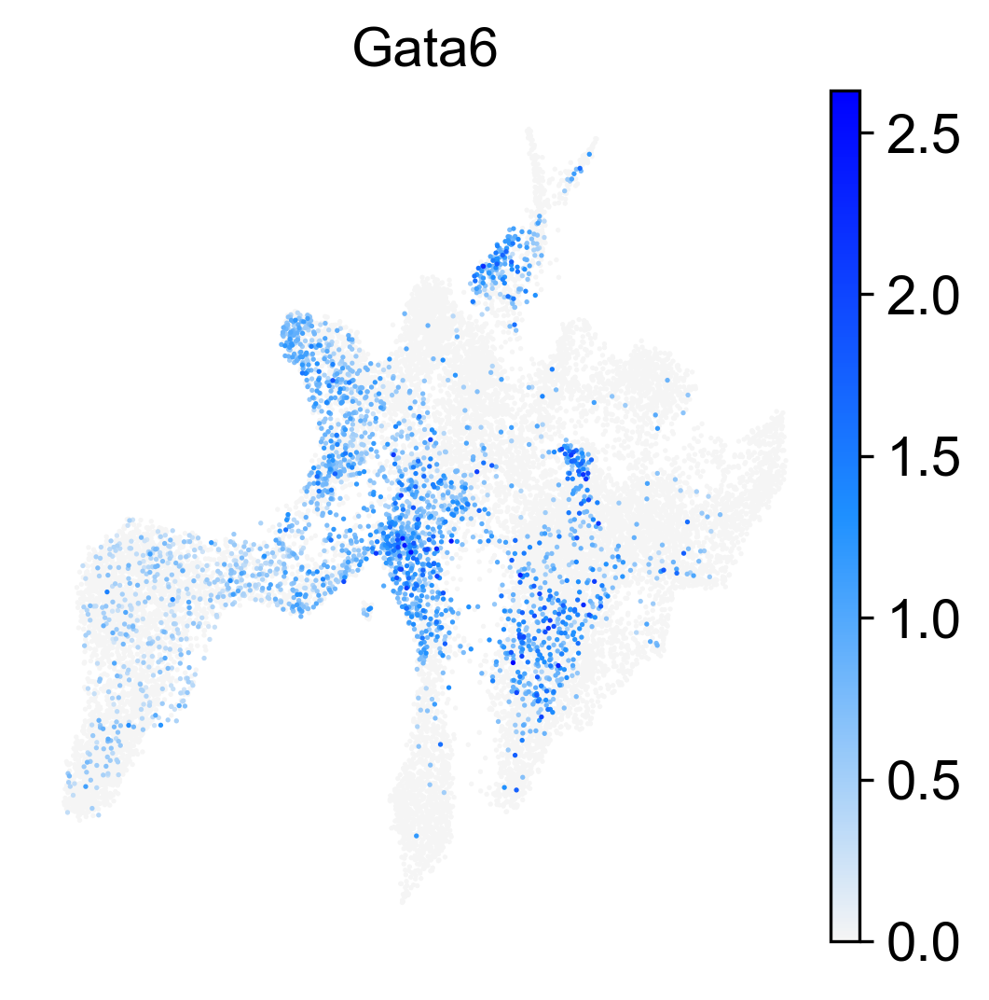

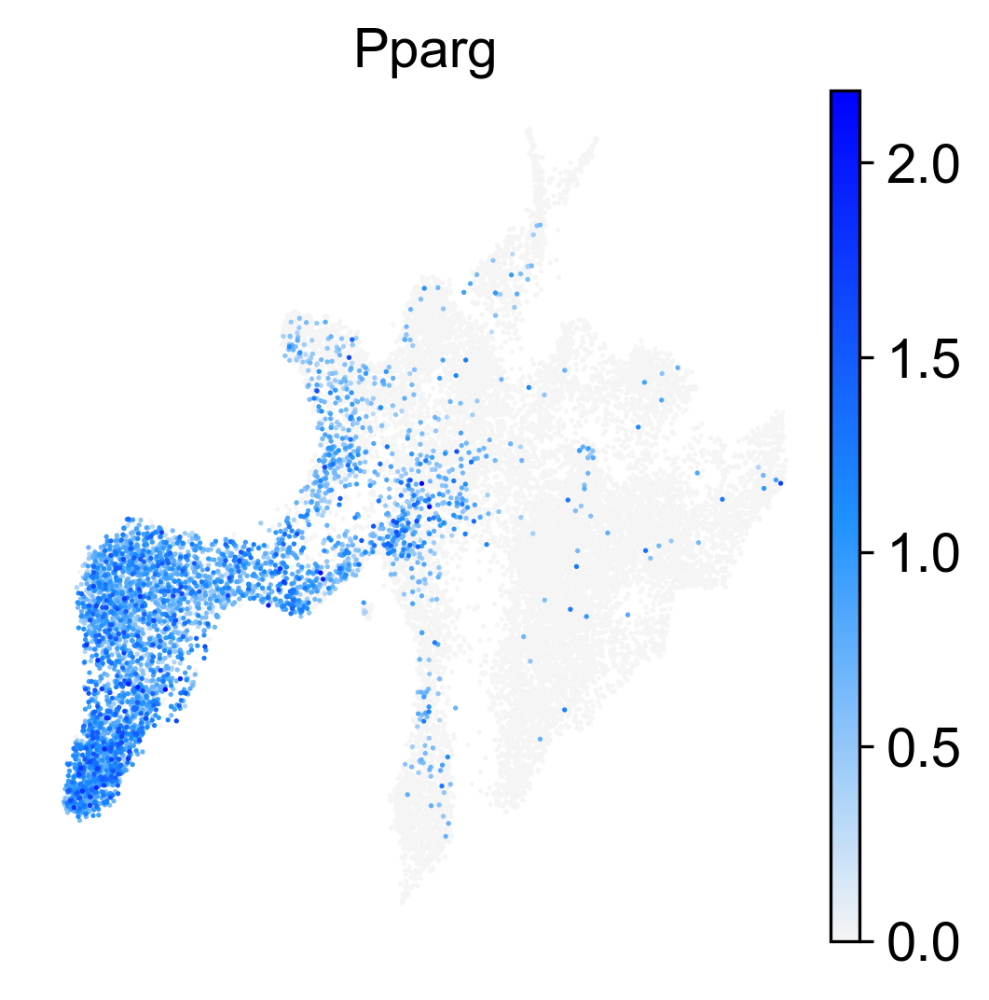

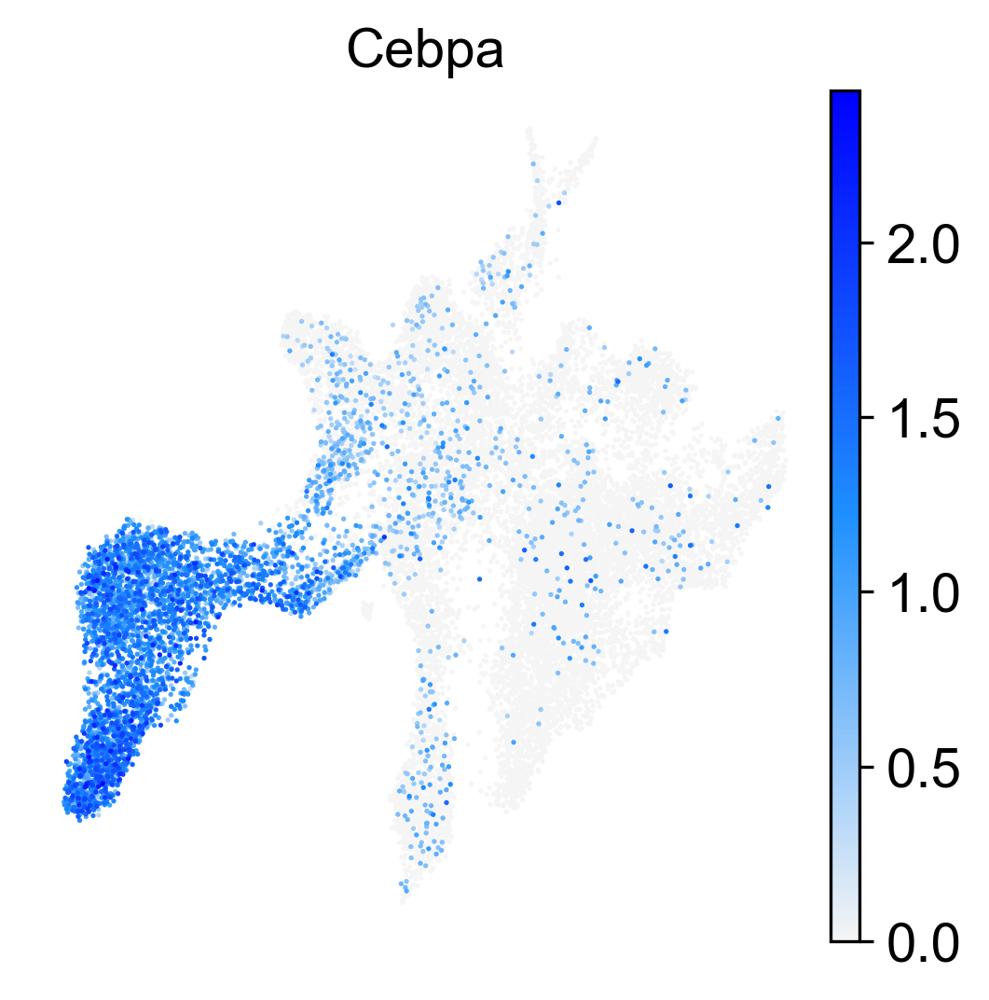

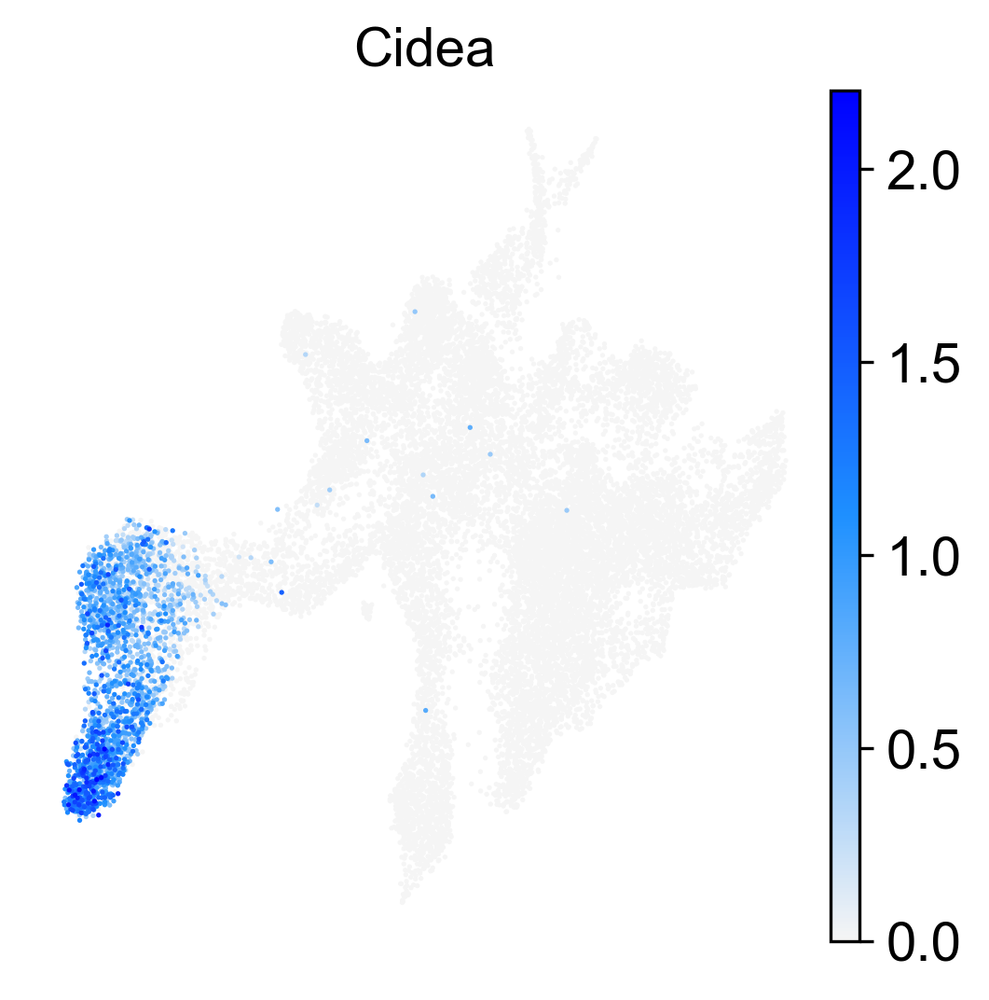

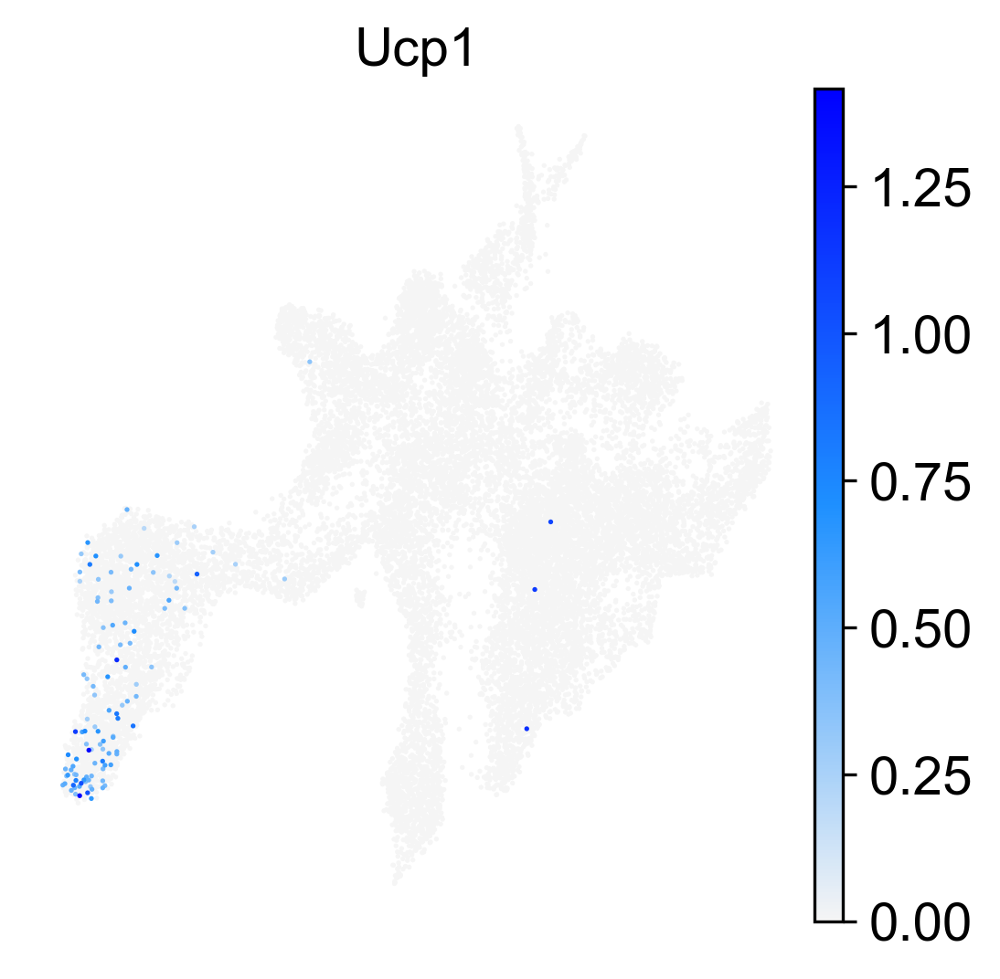

In [60]:
for x in markers_final:
    sc.pl.umap(adata, color=x, color_map=baguette, add_outline=False, save=x+'mouse_umap_genes_signatures_sansrelief.pdf')

In [5]:
markers_final = ['Pdgfra', 'Hic1', 'Ebf2', 'Gata6', 'Pparg', 'Cebpa', 'Cidea', 'Ucp1']

In [24]:
adata_subcluter = adata[:, ['Pdgfra', 'Hic1', 'Ebf2', 'Gata6', 'Pparg', 'Cebpa', 'Cidea', 'Ucp1']]

In [26]:
sc.pp.filter_cells(adata_subcluter, min_counts =1 )
adata_subcluter.shape

Trying to set attribute `.obs` of view, copying.


(5757, 8)

In [70]:
adata.obs.clusters.cat.reorder_categories(['Progenitors', 'Brown Adipocytes Precursors', 'Brown Adipocytes', 'Smooth Muscle', 'Cartilage', 'Tendon', 'Connective Tissue', 'Dermis','Bone', 'Blood'], inplace=True)

In [67]:
ordre_leiden_type=['Progenitors', 'Brown Adipocytes Precursors', 'Brown Adipocytes', 'Smooth Muscle', 'Cartilage', 'Tendon', 'Connective Tissue', 'Dermis','Bone', 'Blood']

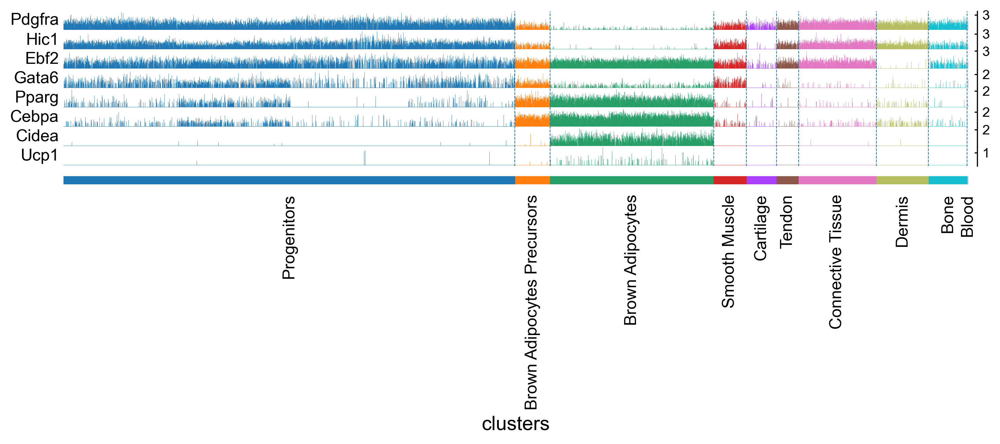

In [73]:
sc.pl.tracksplot(adata, markers_final, groupby='clusters', categories_order=ordre_leiden_type, save='coexpression_curated_marker_genes_tracksplot_mice.pdf', title='Mice')

## Dotplot

In [539]:
markers = {'Brown Adipocytes': ['Cidea', 'Ucp1'],
           'Skeletal Muscle': ['Myog', 'Ttn', 'Actn2', 'Myh3'],
           'Dermal Fibroblast': ['Twist2', 'Dpt', 'Crabp1'],
           'Smooth Muscle': ['Cnn1', 'Acta2'],
           'Muscle connective tissue': ['Ngfr', 'Osr1', 'Osr2'],
           'Cartilage': ['Sox9', 'Col2a1'],
           'Endothelial Cells': ['Cdh5', 'Kdr'],
           'Meninges': ['Foxc1', 'Cldn11', 'Aldh1a2'],
           'Macrophages': ['Csf1r', 'C1qb'],
           'Mast Cells': ['Srgn', 'Kit'],
           'Neutrophils': ['Ngp', 'Lcn2'],
           'Schwann Cells': ['Sox10', 'Mpz'],
           'Epidermal Cells': ['Krt5', 'Krt14'],
          }

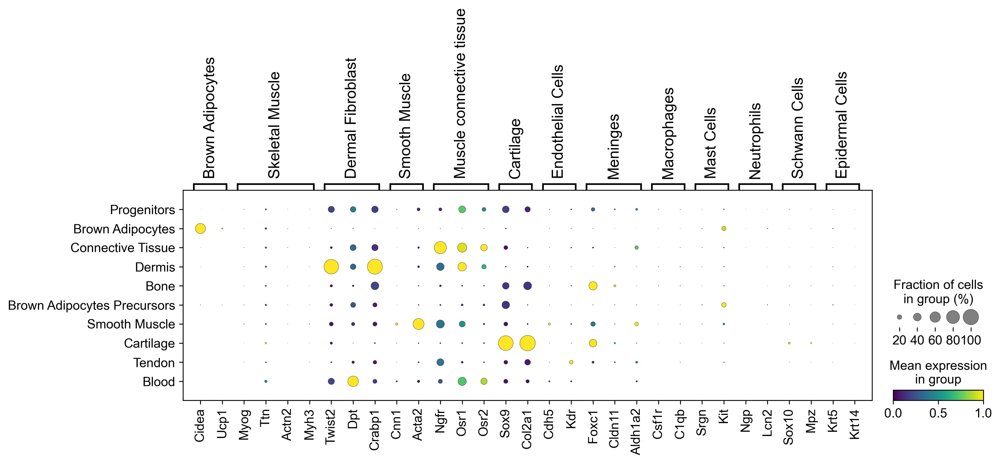

In [540]:
sc.pl.dotplot(adata, var_names=markers ,groupby='clusters',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='mice_all_timepoints_dotplot_leiden_mice_subcluster.pdf', 
              title='')

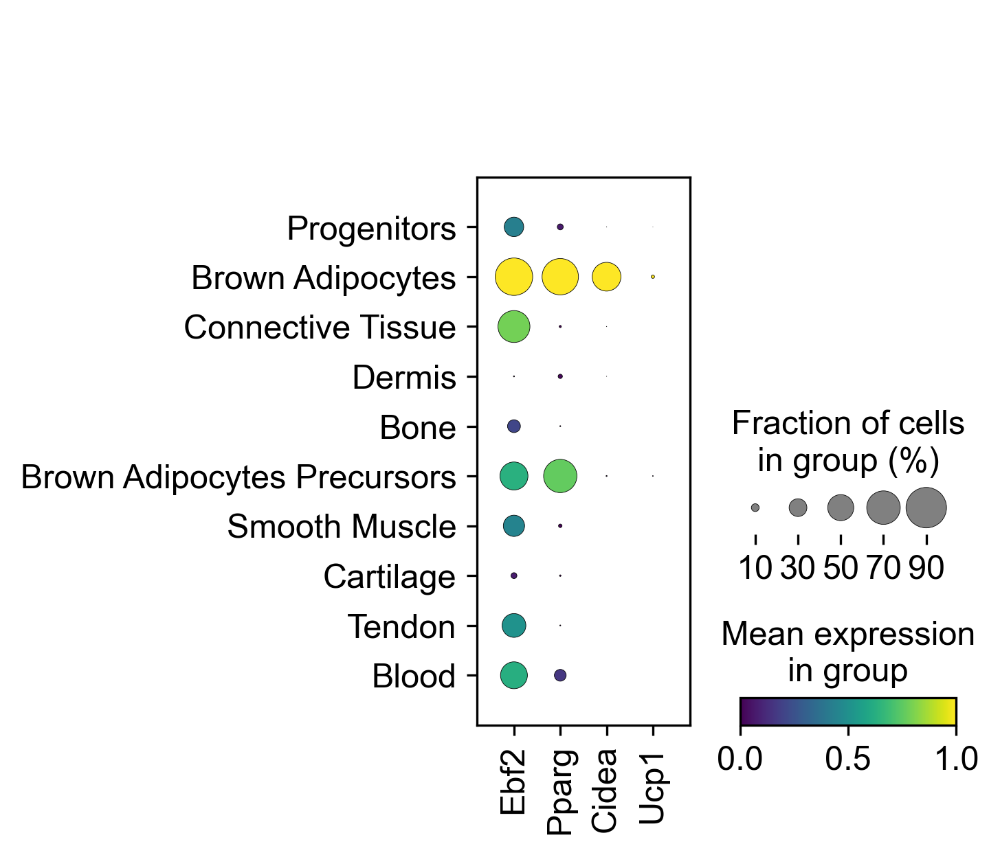

In [34]:
sc.pl.dotplot(adata, var_names=markers_2 ,groupby='clusters',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='mice_all_timepoints_dotplot2_leiden_mice_subcluster.pdf', 
              title='')

In [41]:
signaling = ['Bmp7', 'Bmp4', 'Sfrp1', 'Sfrp2', 'Dkk2', 'Tgfbr2', 'Gdf10', 'Creb3l1', 'Gnas', 'Gpx7', 'Creb5', 'Hsp90b1', 'Akt1', 'Igf1', 'Fgfr1']

In [43]:
adata_sub_pre = adata[adata.obs['clusters'].isin(['Brown Adipocytes Precursors', 'Brown Adipocytes']),:]

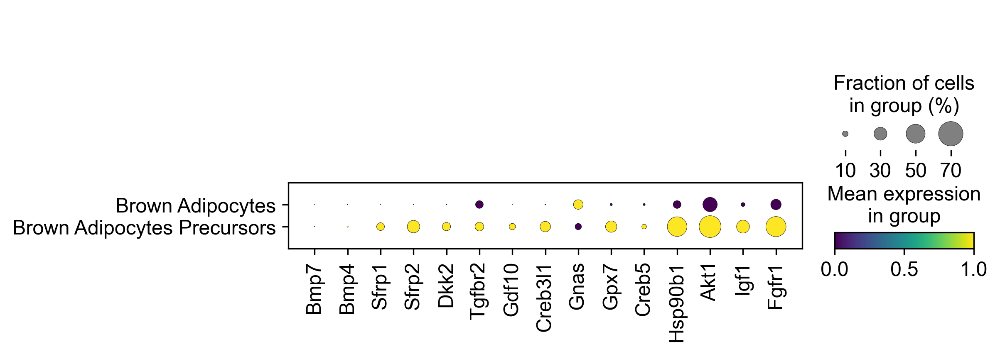

In [45]:
sc.pl.dotplot(adata_sub_pre, var_names=signaling ,groupby='clusters',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='mice_all_timepoints_dotplot_signaling_leiden_mice_subcluster.pdf', 
              title='')

## Bar graph

In [543]:
import copy
cluster_key="clusters"
sample_key="time"
adata_tmp = adata.copy()
adata_tmp = adata_tmp[adata_tmp.obs['clusters'].isin(['Smooth Muscle', 'Brown Adipocytes', 'Brown Adipocytes Precursors', 'Progenitors']),:]

import scanpy_cluster_proportions_v2
cluster_props = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=cluster_key, sample_key=sample_key)

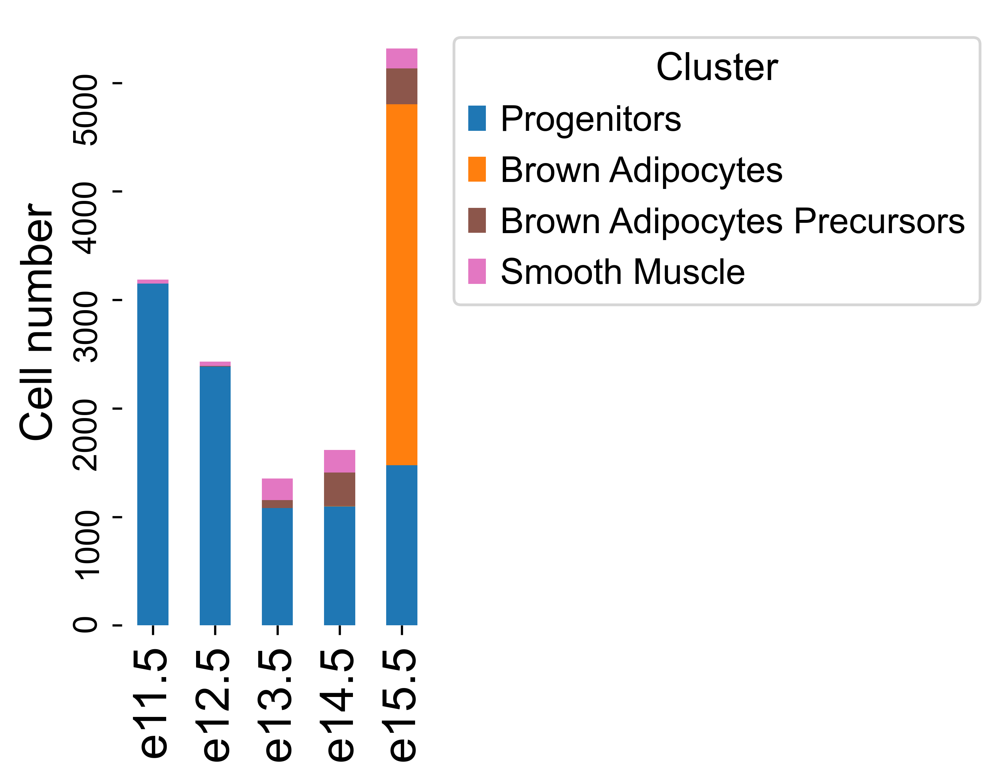

In [544]:
cluster_palette=[Progenitors,BrownAdipocytes,BrownAdipocytesPrecursors,SmoothMuscle]
xlabel_rotation=90
taillepolice=12

fig, ax = plt.subplots(dpi=300)
fig.patch.set_facecolor("white")

cmap = None
if cluster_palette is not None:
    cmap = sns.palettes.blend_palette(
        cluster_palette, 
        n_colors=len(cluster_palette), 
        as_cmap=True)

cluster_props.plot(
    kind="bar",
    stacked=True, 
    ax=ax, 
    legend=False,
    colormap=cmap,
    fontsize='large'
)

ax.legend(bbox_to_anchor=(1.01, 1), frameon=True, title="Cluster")
sns.despine(fig, ax, left=True, bottom=True)
ax.tick_params(axis="y", rotation=xlabel_rotation, labelsize=taillepolice)
ax.set_xlabel('')
ax.set_ylabel("Cell number", fontsize=16)
ax.yaxis.set_label_position("left")
ax.yaxis.tick_left()
fig.set_size_inches(2,4)
plt.yticks(rotation = 90)
ax.grid(False)
plt.savefig('figures/mice_all_timepoints_bar_graph.pdf', bbox_inches = 'tight')

## GATA6

In [37]:
adata_subcluter = sc.read('datasets/gata6_subcluster.h5ad')

In [38]:
import copy
cluster_key="clusters"
sample_key="time"
adata_subcluter.obs['hey'] = 1
adata_tmp = adata_subcluter.copy()

import scanpy_cluster_proportions_v2
df1 = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=sample_key, sample_key=cluster_key)
df1

time,e11.5,e12.5,e13.5,e14.5,e15.5
clusters,,,,,
Progenitors,315,90,250,269,329
Brown Adipocytes,0,0,0,0,145
Connective Tissue,0,0,2,3,17
Dermis,0,0,4,8,0
Bone,0,2,5,3,1
Brown Adipocytes Precursors,0,0,23,92,67
Smooth Muscle,3,1,26,22,80
Cartilage,3,0,0,0,0
Tendon,0,0,4,2,1


In [39]:
import copy
cluster_key="clusters"
sample_key="time"
adata.obs['hey'] = 1
adata_tmp = adata.copy()

import scanpy_cluster_proportions_v2
df2 = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=sample_key, sample_key=cluster_key)
df2

time,e11.5,e12.5,e13.5,e14.5,e15.5
clusters,,,,,
Progenitors,3150,2386,1082,1098,1475
Brown Adipocytes,0,0,0,3,3328
Connective Tissue,6,22,218,521,816
Dermis,1,3,525,531,0
Bone,13,44,386,320,25
Brown Adipocytes Precursors,0,4,73,307,331
Smooth Muscle,38,41,199,208,183
Cartilage,146,254,88,115,6
Tendon,3,12,178,195,63


In [39]:
import copy
cluster_key="clusters"
sample_key="time"
adata.obs['hey'] = 1
adata_tmp = adata.copy()

import scanpy_cluster_proportions_v2
df2 = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=sample_key, sample_key=cluster_key)
df2

time,e11.5,e12.5,e13.5,e14.5,e15.5
clusters,,,,,
Progenitors,3150,2386,1082,1098,1475
Brown Adipocytes,0,0,0,3,3328
Connective Tissue,6,22,218,521,816
Dermis,1,3,525,531,0
Bone,13,44,386,320,25
Brown Adipocytes Precursors,0,4,73,307,331
Smooth Muscle,38,41,199,208,183
Cartilage,146,254,88,115,6
Tendon,3,12,178,195,63


In [79]:
import copy
cluster_key="clusters"
sample_key="time"
adata.obs['hey'] = 1
adata_tmp = adata_subcluter.copy()

import scanpy_cluster_proportions_v2
df2 = scanpy_cluster_proportions_v2.get_cluster_proportions(adata_tmp,cluster_key=sample_key, sample_key=cluster_key)
df2

time,e11.5,e12.5,e13.5,e14.5,e15.5
clusters,,,,,
Progenitors,25.139665,7.182761,19.952115,21.468476,26.256983
Brown Adipocytes,0.000000,0.000000,0.000000,0.000000,100.000000
Connective Tissue,0.000000,0.000000,9.090909,13.636364,77.272727
Dermis,0.000000,0.000000,33.333333,66.666667,0.000000
Bone,0.000000,18.181818,45.454545,27.272727,9.090909
Brown Adipocytes Precursors,0.000000,0.000000,12.637363,50.549451,36.813187
Smooth Muscle,2.272727,0.757576,19.696970,16.666667,60.606061
Cartilage,100.000000,0.000000,0.000000,0.000000,0.000000
Tendon,0.000000,0.000000,57.142857,28.571429,14.285714


In [51]:
pd = (df1/df2).style.format('{:.0%}')

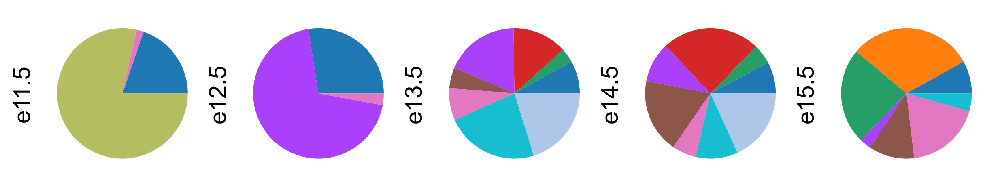

In [78]:
df2.plot.pie(subplots=True, figsize=(10, 10), legend=False, labels=None)
plt.savefig(fname="figures/pieplotGATA6_clusters_proportions.pdf")

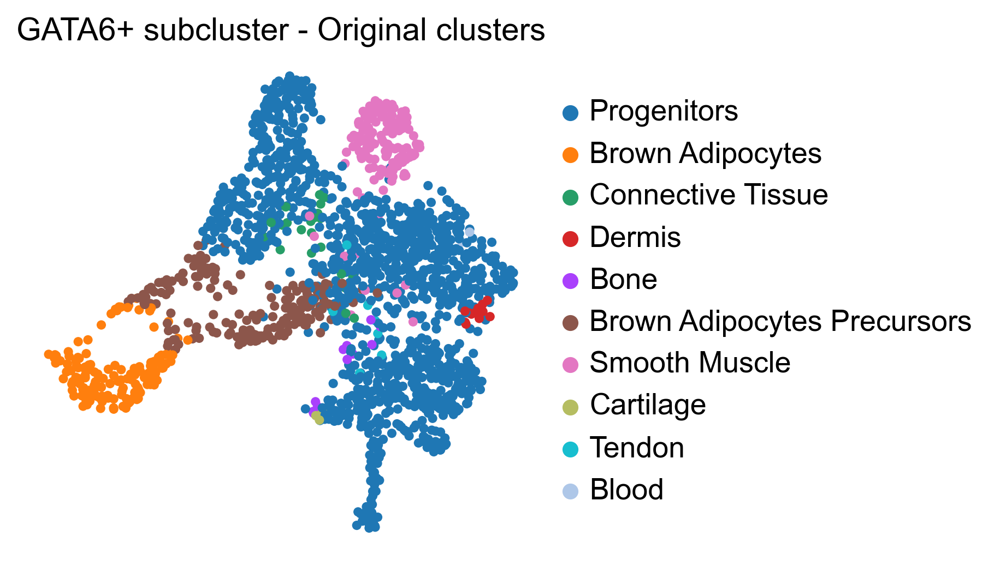

In [26]:
sc.pl.umap(adata_subcluter, color=['clusters'], title='GATA6+ subcluster - Original clusters', save='GATA6_subcluster_original_leiden.pdf')

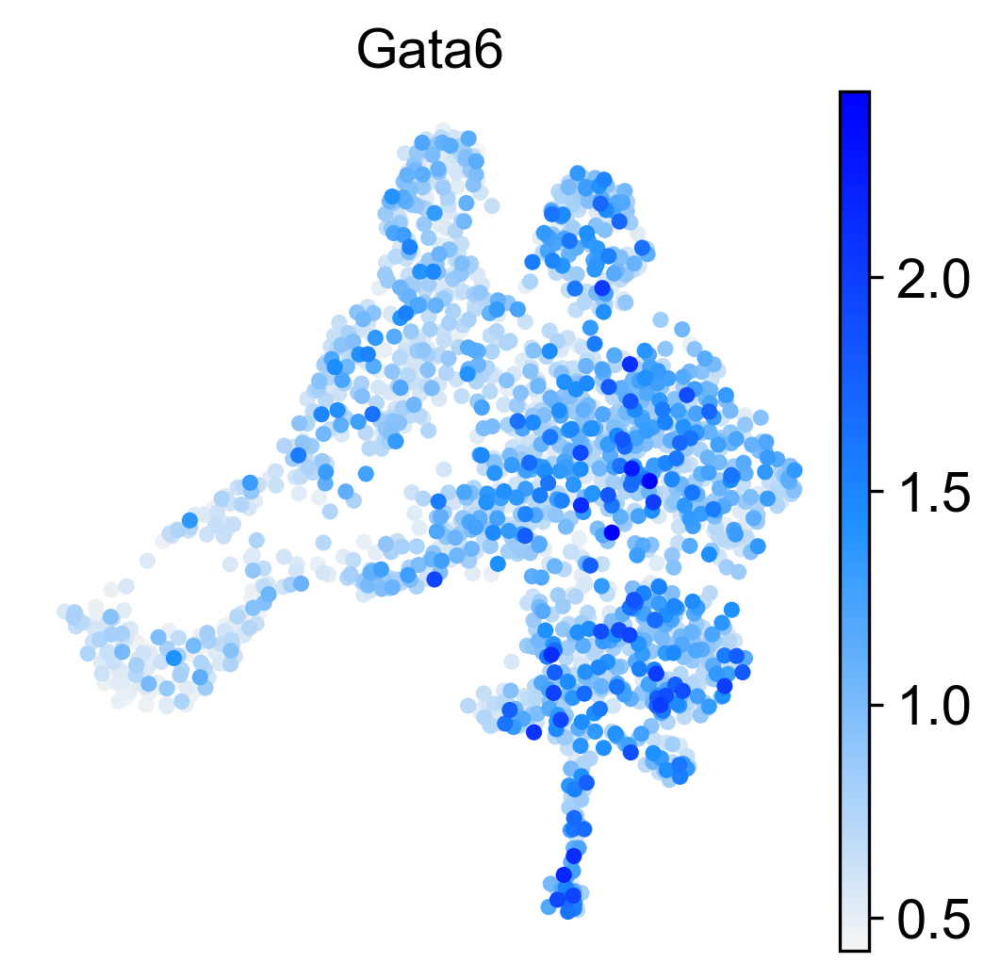

In [27]:
sc.pl.umap(adata_subcluter, color=['Gata6'], color_map=baguette, save='GATA6_subcluster_original_curated_genes.pdf')

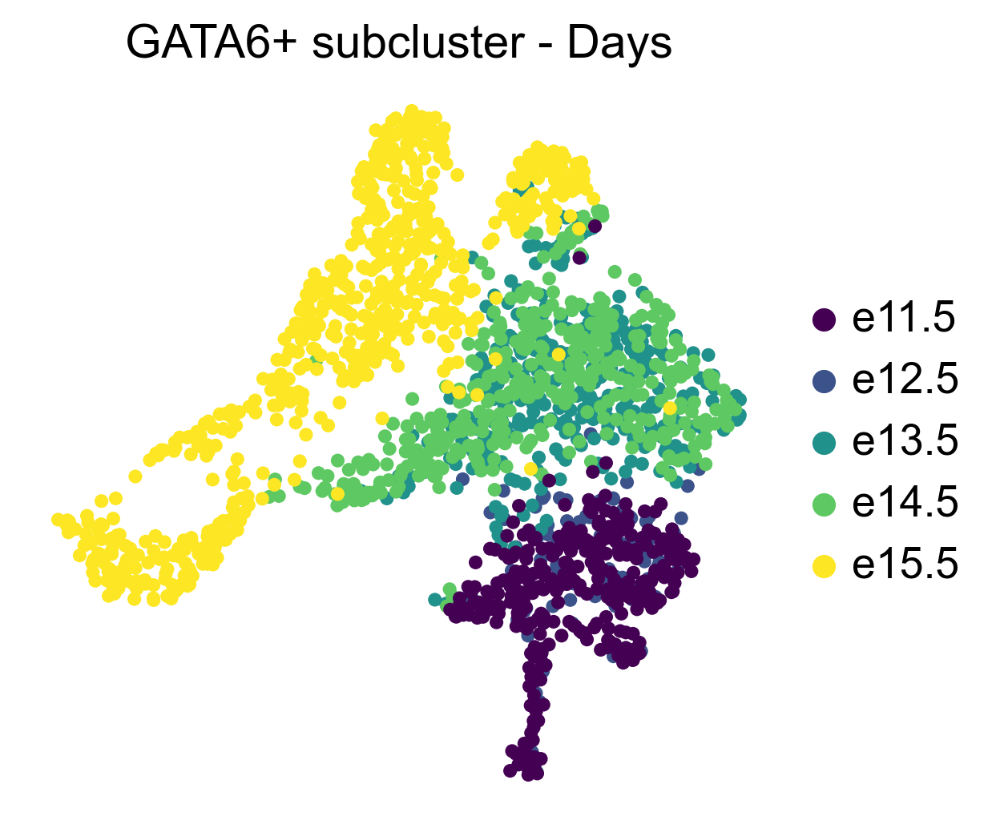

In [547]:
sc.pl.umap(adata_subcluter, color=['time'], title='GATA6+ subcluster - Days', save='PAX7_subcluster_original_time.pdf', palette='viridis')

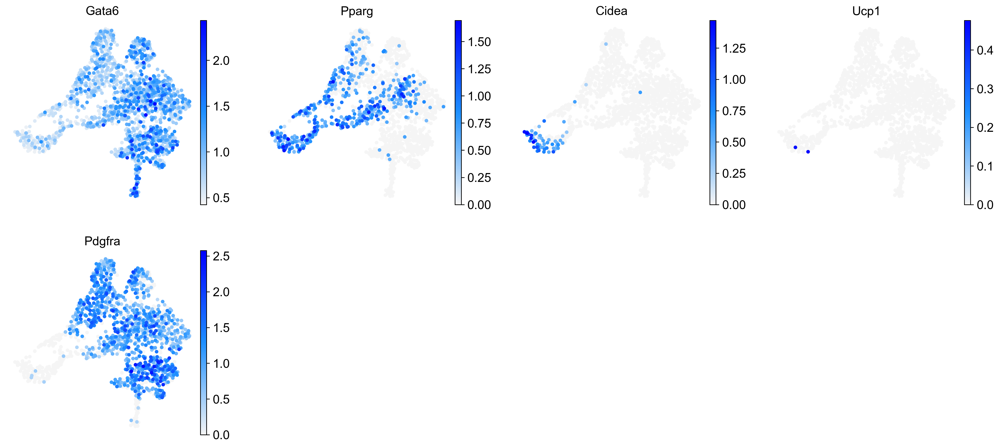

In [548]:
sc.pl.umap(adata_subcluter, color=['Gata6', 'Pparg', 'Cidea', 'Ucp1', 'Pdgfra'], color_map=baguette, save='GATA6_subcluster_original_curated_genes.pdf')

## Signaling

In [549]:
BMP = ['Bmp7', 'Bmp4', 'Bmpr1a', 'Bmpr2']
BMP_title = 'BMP signaling'

TGFB = ['Tgfbr2', 'Gdf10']
TGFB_title = 'TGFbeta signaling'

Trhyroid =['Creb3l1', 'Gnas', 'Gpx7', 'Creb5', 'Hsp90b1']
Trhyroid_title = 'Thyroid hormone signaling'

WNT = ['Sfrp1', 'Sfrp2', 'Sfrp4', 'Dkk2']
WNT_title ='Wnt signaling antagonists'

FGF = ['Akt1', 'Igf1', 'Fgfr1']
FGF_title = 'FGF - PI3-AKT pathway'

In [550]:
master_signaling_list=BMP+TGFB+Trhyroid+WNT+FGF

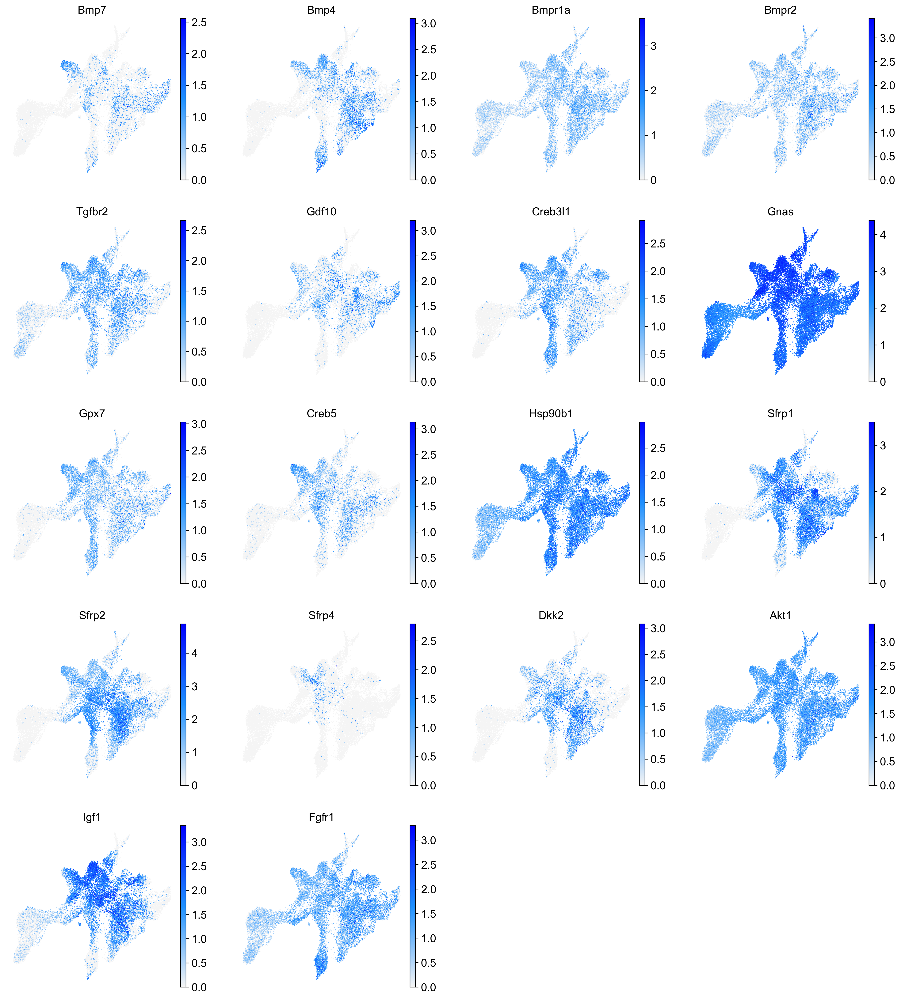

In [551]:
sc.pl.umap(adata, color=master_signaling_list, color_map=baguette, save='mice_UMAP_signaling.pdf')#, use_raw=True)

In [552]:
gene_set_names = gseapy.get_library_name(organism='Human')
sc.tl.rank_genes_groups(adata, groupby='clusters', method = "wilcoxon", n_jobs=-1, key_added = "wilcoxon")

In [553]:
glist = sc.get.rank_genes_groups_df(adata, group='Brown Adipocytes',
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.01)['names'].squeeze().str.strip().tolist()

In [554]:
enr_res1 = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2019_Mouse',
                     cutoff = 0.5)

In [555]:
enr_res1.results.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2019_Mouse,Oxidative phosphorylation,93/134,6.655396e-41,1.983308e-38,0,0,11.231379,1039.021125,NDUFA13;COX7B;NDUFA11;NDUFA12;COX4I1;NDUFA10;A...
1,KEGG_2019_Mouse,Thermogenesis,127/231,3.290635e-39,4.903047e-37,0,0,6.085441,539.229360,KLB;ATF2;NDUFA13;NDUFA11;NDUFA12;NDUFA10;ATP5C...
2,KEGG_2019_Mouse,Parkinson disease,90/144,4.166936e-34,4.139156e-32,0,0,8.238551,633.220923,NDUFA13;COX7B;NDUFA11;NDUFA12;COX4I1;NDUFA10;A...
3,KEGG_2019_Mouse,Non-alcoholic fatty liver disease (NAFLD),91/151,1.115371e-32,8.309515e-31,0,0,7.496602,551.551500,NDUFA13;GSK3A;COX7B;NDUFA11;NDUFA12;COX4I1;NDU...
4,KEGG_2019_Mouse,Huntington disease,102/192,4.633256e-30,2.761421e-28,0,0,5.610153,378.933831,NDUFA13;NDUFA11;NDUFA12;NDUFA10;ATP5C1;COX6A1;...
5,KEGG_2019_Mouse,Alzheimer disease,93/175,1.541409e-27,7.655666e-26,0,0,5.601759,345.836343,NDUFA13;COX7B;NDUFA11;NDUFA12;COX4I1;NDUFA10;A...
6,KEGG_2019_Mouse,Ribosome,89/170,8.594761e-26,3.658913e-24,0,0,5.420839,312.869475,RPL4;MRPS17;RPL30;MRPS15;RPL3;MRPS16;MRPS14;RP...
7,KEGG_2019_Mouse,Peroxisome,50/84,2.990868e-18,1.114098e-16,0,0,7.192007,290.204454,PECR;ABCD3;ECI2;MPV17L2;SCP2;NUDT19;MLYCD;NUDT...
8,KEGG_2019_Mouse,Citrate cycle (TCA cycle),28/32,5.841486e-18,1.934181e-16,0,0,34.074346,1352.122750,PCX;DLST;PDHB;IDH3B;DLAT;PCK1;CSL;PCK2;IDH3A;P...
9,KEGG_2019_Mouse,Propanoate metabolism,27/31,3.001740e-17,8.945186e-16,0,0,32.847753,1249.684681,ACSS3;ECHS1;ACSS2;ACACB;ACAT2;ACAT1;LDHB;MCEE;...


In [556]:
enr_res2 = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Biological_Process_2018')#, cutoff = 0.5)

In [557]:
enr_res2.results.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,mitochondrial translation (GO:0032543),98/107,2.031319e-64,8.665607e-61,0,0,54.101410,7934.337554,MTRF1;CHCHD1;EARS2;RARS2;MRPS18B;MRPS18A;TUFM;...
1,GO_Biological_Process_2018,mitochondrial translational elongation (GO:007...,84/87,1.271913e-60,2.712990e-57,0,0,138.586197,19113.057617,MRPS17;MRPS15;GFM1;MRPS16;MRPS14;MRPS11;MRPS12...
2,GO_Biological_Process_2018,translational termination (GO:0006415),89/96,9.258287e-60,1.316528e-56,0,0,63.008378,8564.702800,N6AMT1;MRPS17;MRPS15;MRPS16;MRPS14;GFM2;MRPS11...
3,GO_Biological_Process_2018,mitochondrial translational termination (GO:00...,84/89,3.466168e-58,3.696668e-55,0,0,83.141679,11000.216647,MRPS17;MRPS15;MRPS16;MRPS14;GFM2;MRPS11;MRPS12...
4,GO_Biological_Process_2018,translation (GO:0006412),144/232,2.401967e-53,2.049358e-50,0,0,8.204718,994.089595,RPL4;N6AMT1;RPL30;RPL3;VARS;RPL34;EPRS;RPL8;AP...
5,GO_Biological_Process_2018,translational elongation (GO:0006414),87/105,3.002510e-49,2.134785e-46,0,0,23.922398,2672.783081,MRPS17;MRPS15;GFM1;MRPS16;MRPS14;MRPS11;MRPS12...
6,GO_Biological_Process_2018,mitochondrial respiratory chain complex assemb...,77/97,3.916840e-41,2.387034e-38,0,0,18.996318,1767.430776,NDUFA13;NDUFA11;NDUFA12;FASTKD3;NDUFA10;ECSIT;...
7,GO_Biological_Process_2018,cellular macromolecule biosynthetic process (G...,172/367,2.221326e-40,1.184522e-37,0,0,4.431638,404.632019,RPL4;RPL30;RPL3;RPL34;RPL8;RPL10A;NR3C1;RPL9;Y...
8,GO_Biological_Process_2018,respiratory electron transport chain (GO:0022904),74/94,4.065349e-39,1.926975e-36,0,0,18.239887,1612.375333,COX7B;NDUFA13;NDUFA11;NDUFA12;COX4I1;NDUFA10;E...
9,GO_Biological_Process_2018,mitochondrial ATP synthesis coupled electron t...,67/85,1.345822e-35,5.741279e-33,0,0,18.313466,1470.451796,COX7B;NDUFA13;NDUFA11;NDUFA12;COX4I1;NDUFA10;T...


In [558]:
enr_res3 = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='WikiPathways_2019_Mouse')#, cutoff = 0.5)

In [559]:
enr_res3.results.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,WikiPathways_2019_Mouse,Electron Transport Chain WP295,77/103,8.176613e-38,1.324611e-35,0,0,14.607254,1247.415043,COX7B;NDUFA12;COX4I1;NDUFA10;ATP5C1;ATP5G3;COX...
1,WikiPathways_2019_Mouse,Oxidative phosphorylation WP1248,45/62,9.380507e-22,7.598211e-20,0,0,12.939787,626.521674,ATP5S;NDUFB9;NDUFB8;NDUFB7;NDUFA11;NDUFB6;NDUF...
2,WikiPathways_2019_Mouse,TCA Cycle WP434,28/31,8.738030e-19,4.718536e-17,0,0,45.435204,1889.260854,PCX;DLST;PDHB;PDK4;IDH3B;DLAT;PDK2;PDK1;IDH3A;...
3,WikiPathways_2019_Mouse,Amino Acid metabolism WP662,53/95,1.580599e-17,6.401427e-16,0,0,6.173919,238.845129,HIBADH;VARS;EPRS;AUH;PDK4;ACADM;HADH;GLUL;HIBC...
4,WikiPathways_2019_Mouse,Fatty Acid Beta Oxidation WP1269,25/34,7.057508e-13,2.286632e-11,0,0,13.505578,377.879523,GCDH;ACADVL;ECHS1;ACSS2;ECI1;LPL;ACAT1;LIPE;AC...
5,WikiPathways_2019_Mouse,Cytoplasmic Ribosomal Proteins WP163,42/92,1.939624e-10,5.236985e-09,0,0,4.094411,91.564782,RPL4;RPL30;RPL3;RPL34;RPL10A;RPL8;RPL9;RPS15;R...
6,WikiPathways_2019_Mouse,Mitochondrial LC-Fatty Acid Beta-Oxidation WP401,14/16,1.585168e-09,3.668531e-08,0,0,33.938835,687.688216,PECR;ACADVL;ACSL1;ECI1;ACSL4;HADHA;ACADL;CPT2;...
7,WikiPathways_2019_Mouse,Proteasome Degradation WP519,27/52,1.064576e-08,2.155767e-07,0,0,5.248978,96.361278,PSMD12;PSMD13;PSMB10;PSMA7;PSMD8;PSMB6;PSMB7;P...
8,WikiPathways_2019_Mouse,mRNA processing WP310,126/457,1.330167e-08,2.394301e-07,0,0,1.870267,33.917996,SRP19;EIF4A3;HNRNPU;PARK7;MSI2;RPL8;RPL9;RDM1;...
9,WikiPathways_2019_Mouse,DNA Replication WP150,23/41,1.899213e-08,3.076726e-07,0,0,6.205546,110.329894,CDT1;PCNA;RFC4;MCM7;RFC1;RFC2;GMNN;RPA1;MCM10;...


## Trajectory

In [479]:
import sys

if "google.colab" in sys.modules:
    !pip install -q git+https://github.com/theislab/cellrank@dev#egg=cellrank[external,krylov]

import matplotlib.pyplot as plt
import scvelo as scv
import scanpy as sc
import cellrank as cr
import wot

# import CellRank kernels and estimators
from cellrank.external.kernels import WOTKernel
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.estimators import GPCCA

# set verbosity levels
cr.settings.verbosity = 2
scv.settings.verbosity = 3

# figure settings
scv.settings.set_figure_params(
    "scvelo", dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map="viridis")

In [480]:
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=500, frameon=False, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True)

In [306]:
adata = sc.read('datasets/all_mice_timepoints_trajectory.h5ad')

In [481]:
adata.obs['day'] = adata.obs['time']

In [482]:
adata.obs['day'] = adata.obs['day'].replace(['e11.5'],11.5)
adata.obs['day'] = adata.obs['day'].replace(['e12.5'],12.5)
adata.obs['day'] = adata.obs['day'].replace(['e13.5'],13.5)
adata.obs['day'] = adata.obs['day'].replace(['e14.5'],14.5)
adata.obs['day'] = adata.obs['day'].replace(['e15.5'],15.5)

In [483]:
wk = WOTKernel(adata, time_key="day")

In [484]:
wk.compute_initial_growth_rates(organism="mouse", key_added="growth_rate_init")

Computing `proliferation` scores
Computing `apoptosis` scores


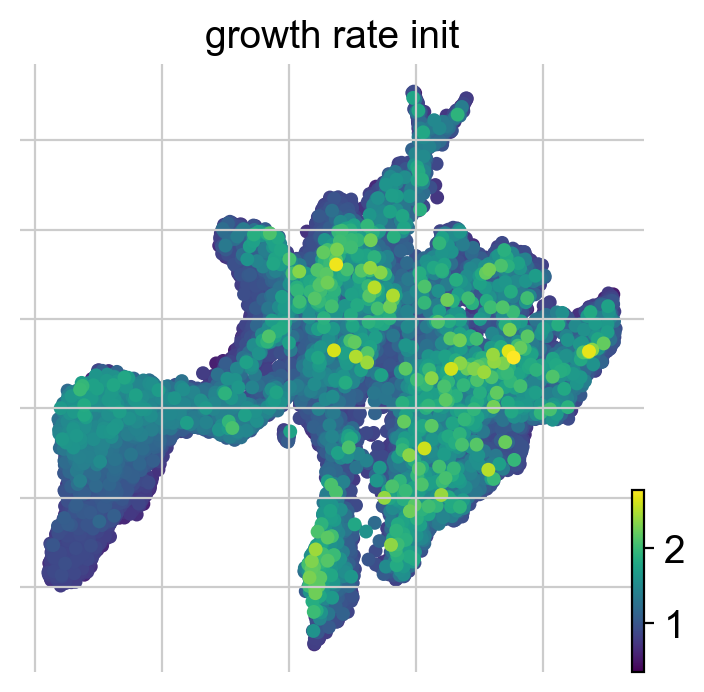

In [485]:
scv.pl.scatter(
    adata, c="growth_rate_init", legend_loc="right", basis="X_umap", s=100
)

In [486]:
wk.compute_transition_matrix(
    growth_iters=3, growth_rate_key="growth_rate_init", last_time_point="connectivities",
)

Computing transition matrix using Waddington optimal transport
Using `3741` HVGs from `adata.var['highly_variable']`
Using default cost matrices
Computing transport maps for `4` time pairs


  0%|          | 0/4 [00:00<?, ?time pair/s]

    Finish (0:02:18)
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Using `threshold=0.0008159310674094558`
    Finish (0:02:26)


<WOTKernel>

Simulating `10000` random walks of maximum length `500`


  0%|          | 0/10000 [00:00<?, ?sim/s]

    Finish (0:01:29)
Plotting random walks


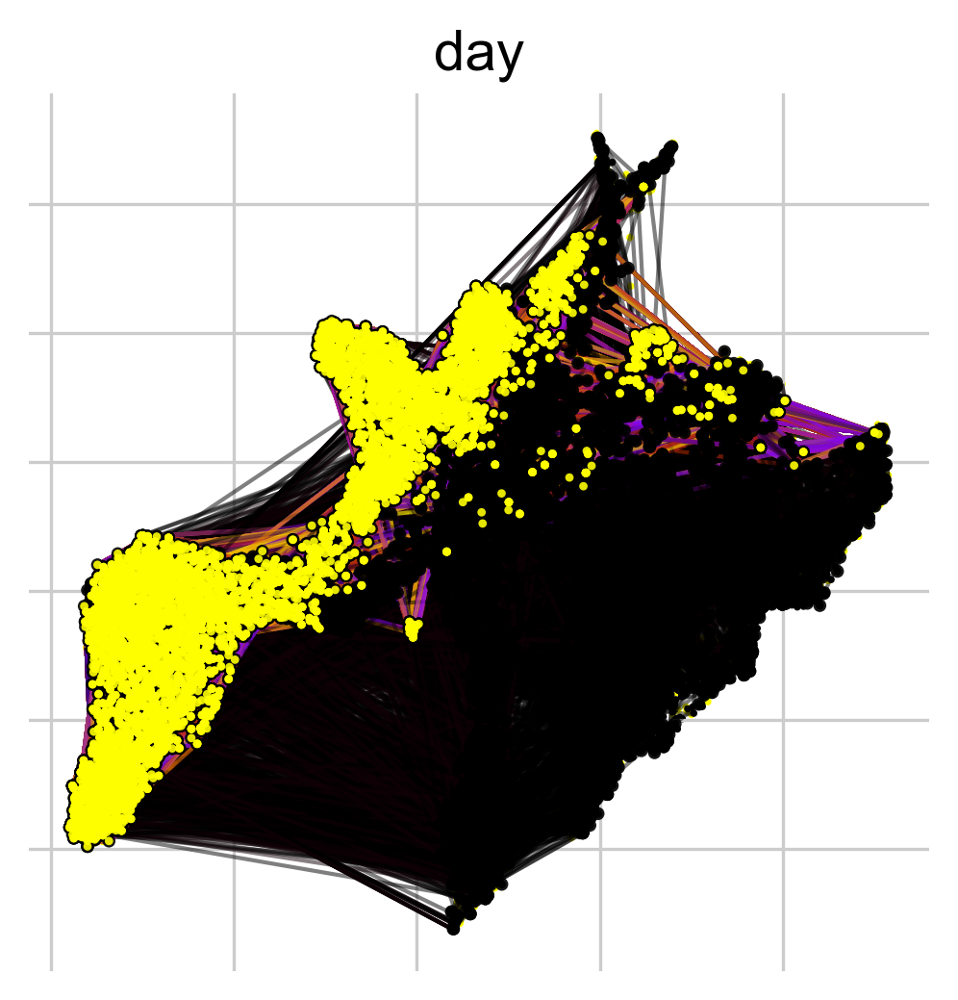

In [487]:
wk.plot_random_walks(
    n_sims=10000,
    max_iter=500,
    start_ixs={"day": 0.0},
    basis="X_umap",
    c="day",
    legend_loc="none",
    linealpha=0.5,
    dpi=150,
    n_jobs=-1
)


Computing flow from `Progenitors` into `9` cluster(s) in `3` time points
Plotting flow from `Progenitors` into `6` cluster(s) in `3` time points


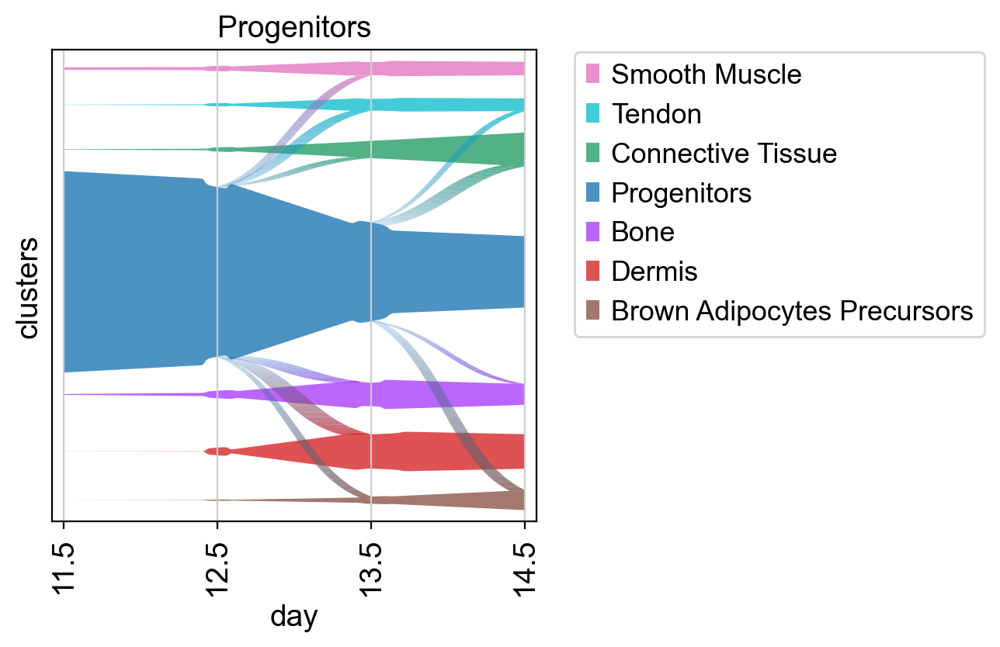

In [561]:
ax = wk.plot_single_flow(
    cluster_key="clusters",
    time_key="day",
    cluster="Progenitors",
    min_flow=0.02,
    xticks_step_size=1,
    show=False,
    dpi=100,
    ascending=False,
    clusters=adata.obs.clusters.cat.categories.to_list(),
    save='flow_brown_progenitors1.pdf',
    time_points=[11.5,12.5,13.5,14.5],
)

# prettify the plot a bit, rotate x-axis tick labels
locs, labels = plt.xticks()
ax.set_xticks(locs)
ax.set_xticklabels(labels, rotation=90)

plt.show()

Computing flow from `Brown Adipocytes Precursors` into `9` cluster(s) in `4` time points
Plotting flow from `Brown Adipocytes Precursors` into `1` cluster(s) in `4` time points


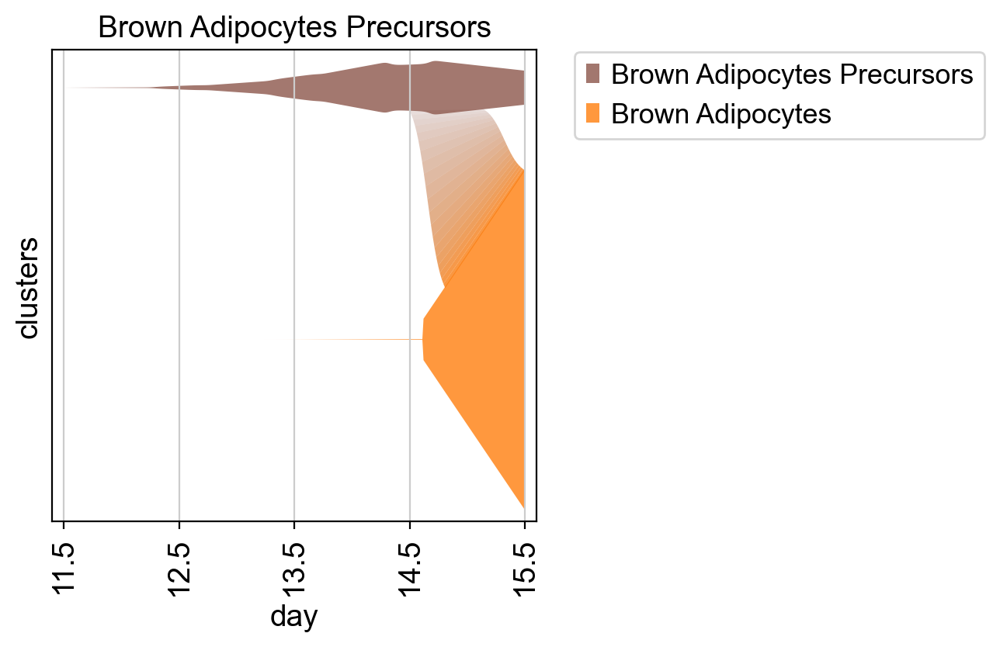

In [562]:
ax = wk.plot_single_flow(
    cluster_key="clusters",
    time_key="day",
    cluster="Brown Adipocytes Precursors",
    min_flow=0.5,
    xticks_step_size=1,
    show=False,
    dpi=100,
    ascending=False,
    clusters=adata.obs.clusters.cat.categories.to_list(),
    save='flow_brown_adipocytes_precursors.pdf',
    time_points=[11.5,12.5,13.5,14.5,15.5],
)

# prettify the plot a bit, rotate x-axis tick labels
locs, labels = plt.xticks()
ax.set_xticks(locs)
ax.set_xticklabels(labels, rotation=90)

plt.show()

In [490]:
sc.tl.paga(adata, groups='clusters')

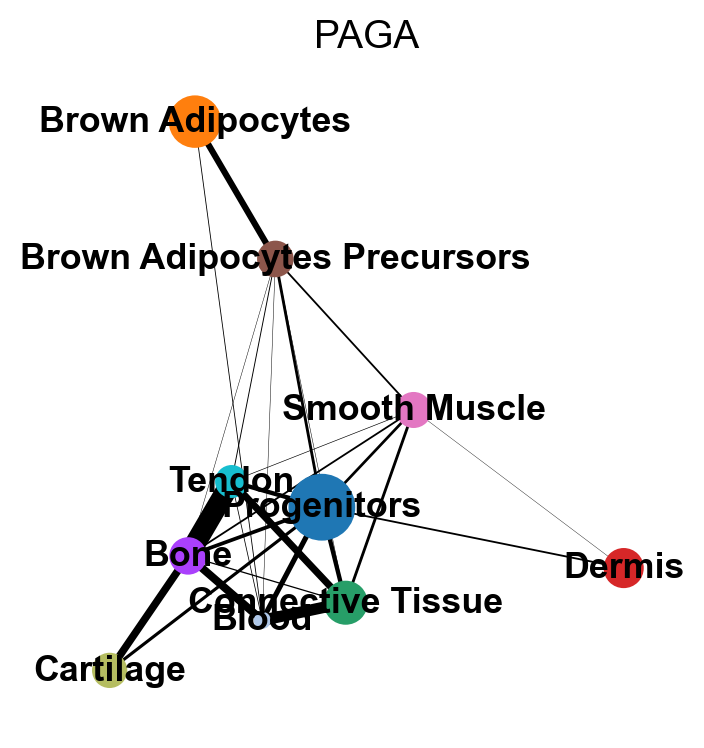

In [491]:
sc.pl.paga(adata, title='PAGA')

In [492]:
sc.tl.diffmap(adata, n_comps=15)

In [493]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['clusters'] == 'Progenitors')[0]

In [494]:
sc.tl.dpt(adata, n_dcs=15)

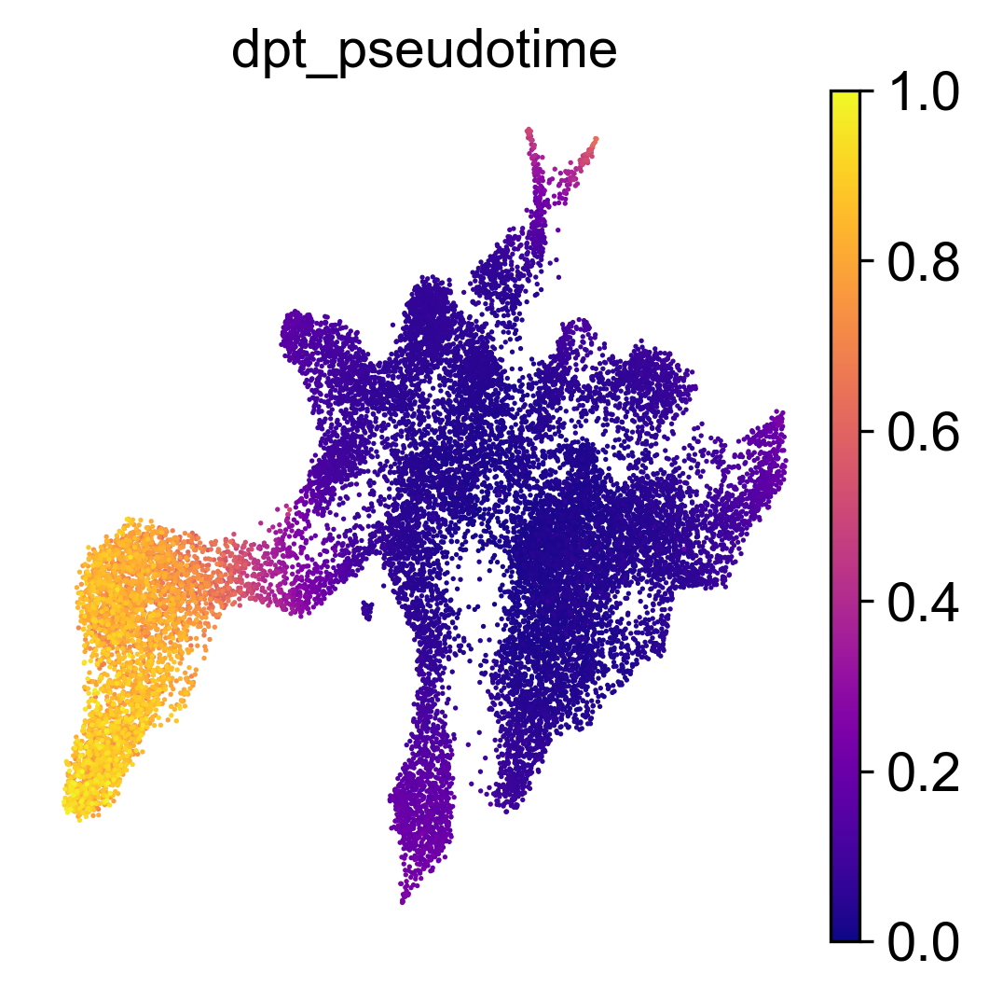

In [563]:
sc.pl.umap(adata, color=['dpt_pseudotime'], save='pseudotime.pdf', color_map='plasma')